In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import GroupKFold, train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import seaborn as sns
import random

df = pd.read_csv('Adjusted_Startup_Data.csv', encoding='latin1')

In [2]:
sample = df.sample(frac=0.1) # taking 10% of the data as a sample
print(sample.dtypes)

Company_Name                 object
Prediction                    int64
year of founding             object
Age of company in years      object
Internet Activity Score     float64
                             ...   
Percent_skill_Law            object
Percent_skill_Consulting     object
Percent_skill_Finance        object
Percent_skill_Investment     object
Renown score                 object
Length: 114, dtype: object


In [3]:
#identifying inconsistent values
inconsistent_values = df.apply(lambda x: x.unique().shape[0] != x.shape[0], axis=0)
print(inconsistent_values)

Company_Name                False
Prediction                   True
year of founding             True
Age of company in years      True
Internet Activity Score      True
                            ...  
Percent_skill_Law            True
Percent_skill_Consulting     True
Percent_skill_Finance        True
Percent_skill_Investment     True
Renown score                 True
Length: 114, dtype: bool


In [4]:
#Observe the layout of the dataset on a high level
df.describe()

,Prediction,Internet Activity Score,Industry of company_1,Employee Count,Employees count MoM change,Last Funding Amount,Number of Co-founders,Number of of advisors,Team size Senior leadership,Industry trend in investing
count,472.000000,407.000000,472.000000,306.000000,267.000000,3.120000e+02,472.000000,472.000000,472.000000,390.000000
mean,0.646186,114.159705,11.569915,31.408497,-1.299625,6.379489e+06,1.868644,1.016949,3.730932,2.889744
std,0.478660,225.651419,11.000839,62.673600,23.967085,9.901622e+06,1.143481,2.014736,2.516539,0.845765
min,0.000000,-725.000000,0.000000,0.000000,-100.000000,1.000000e+04,0.000000,0.000000,1.000000,0.000000
25%,0.000000,-3.500000,3.000000,4.250000,0.000000,7.500000e+05,1.000000,0.000000,2.000000,2.000000
50%,1.000000,60.000000,7.000000,13.000000,0.000000,2.800000e+06,2.000000,0.000000,3.000000,3.000000
75%,1.000000,216.000000,23.000000,31.000000,6.000000,7.850000e+06,2.250000,1.000000,5.000000,3.000000
max,1.000000,1535.000000,36.000000,594.000000,50.000000,7.700000e+07,7.000000,13.000000,24.000000,5.000000


Histogram and Boxplot

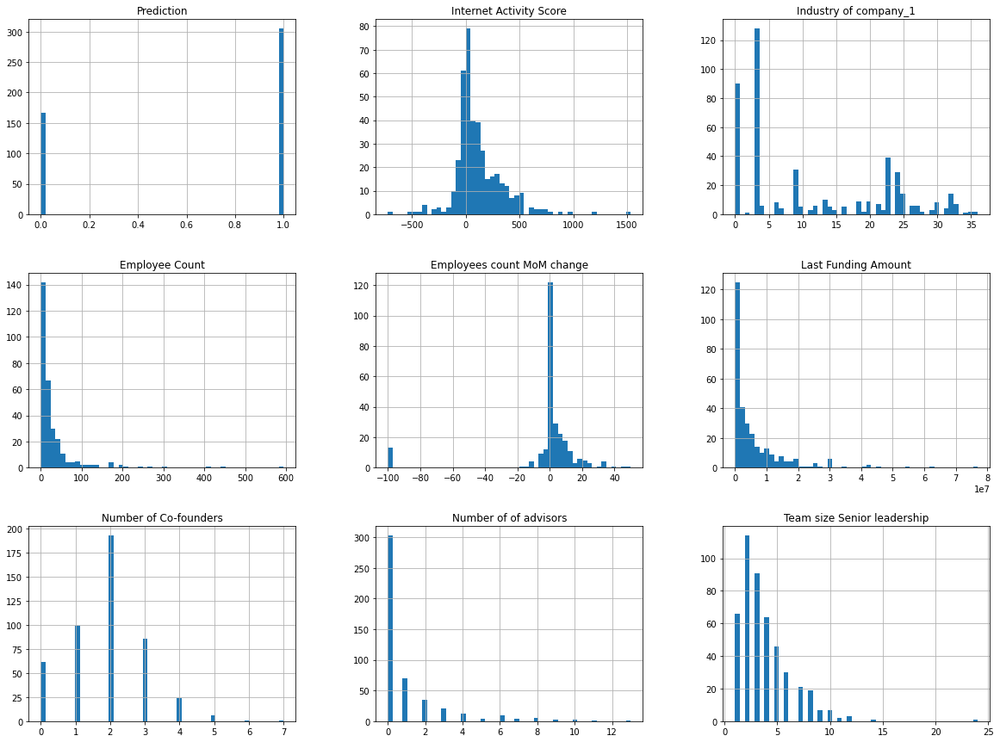

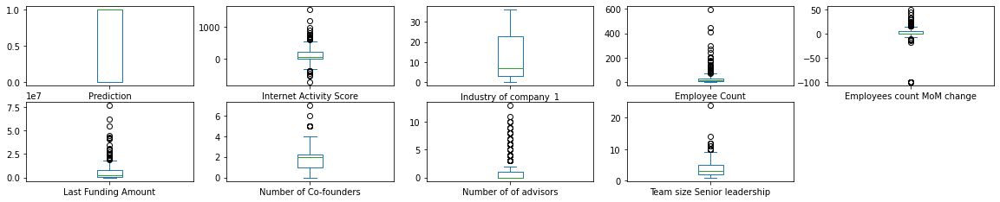

In [5]:
# Select a subset of columns (the first 57 features)
selected_features = df.iloc[:, 0:57]
# Histograms for selected features
selected_features.hist(bins=50, figsize=(20,15))
plt.show()

# Box plots for selected features
selected_features.plot(kind='box', subplots=True, layout=(10, 5), figsize=(20, 20))
plt.show()


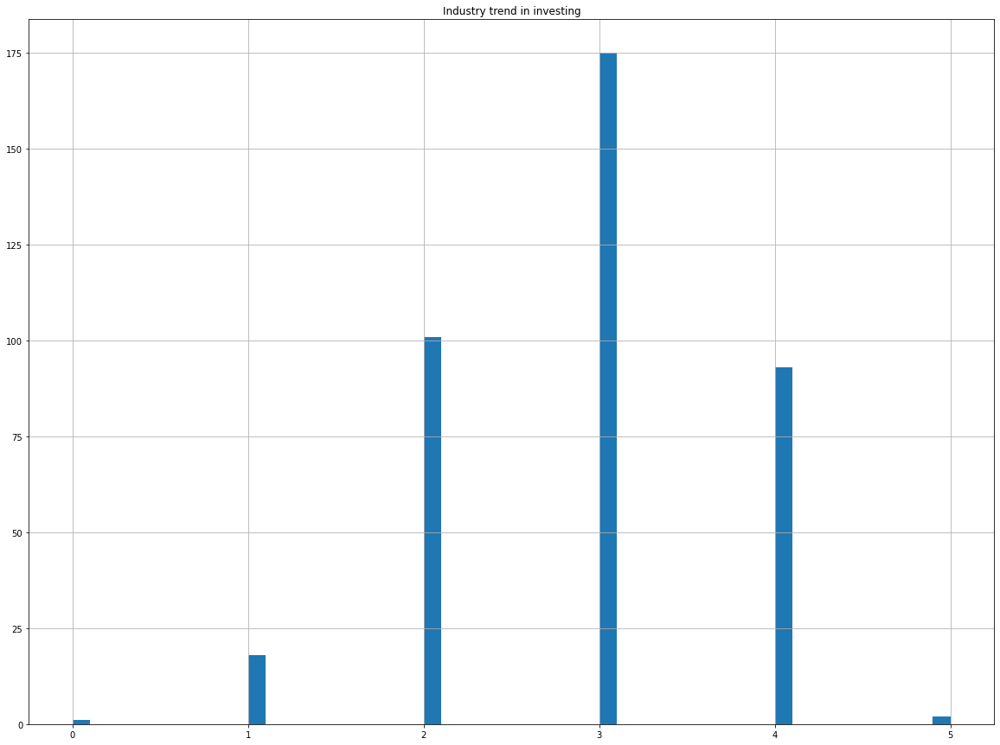

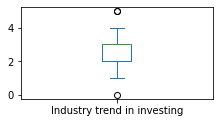

In [6]:
# Select a subset of columns (the last 57 features)
selected_features = df.iloc[:, 58:114]
# Histograms for selected features
selected_features.hist(bins=50, figsize=(20,15))
plt.show()

# Box plots for selected features
selected_features.plot(kind='box', subplots=True, layout=(10, 5), figsize=(20, 20))
plt.show()

In [7]:
# Check for missing values in each column
missing_values = df.isnull().any()

# Count the number of columns with missing values
num_columns_with_missing = missing_values.sum()

# Print the results
print("Number of columns with missing values:", num_columns_with_missing)
print("Columns with missing values:\n", missing_values)

# Check total number of missing values in the DataFrame
print("Total missing values:", df.isnull().sum().sum())
# Calculate the percentage of cells with missing values
percent_missing = df.isnull().sum().sum() / df.size * 100
print("Percentage of cells with missing values:", percent_missing)

Number of columns with missing values: 14
Columns with missing values:
 Company_Name                False
Prediction                  False
year of founding            False
Age of company in years      True
Internet Activity Score      True
                            ...  
Percent_skill_Law           False
Percent_skill_Consulting    False
Percent_skill_Finance       False
Percent_skill_Investment    False
Renown score                False
Length: 114, dtype: bool
Total missing values: 1586
Percentage of cells with missing values: 2.9475170978293193


In [8]:
#Investigate individual features of selected observations for a better understanding

solutions_offered = df["Number of  Sales Support material"]

# To display all rows from the column (might be long!)
print(solutions_offered)


0      Nothing
1      Nothing
2       medium
3       medium
4       medium
        ...   
467     medium
468     medium
469     medium
470     medium
471        low
Name: Number of  Sales Support material, Length: 472, dtype: object


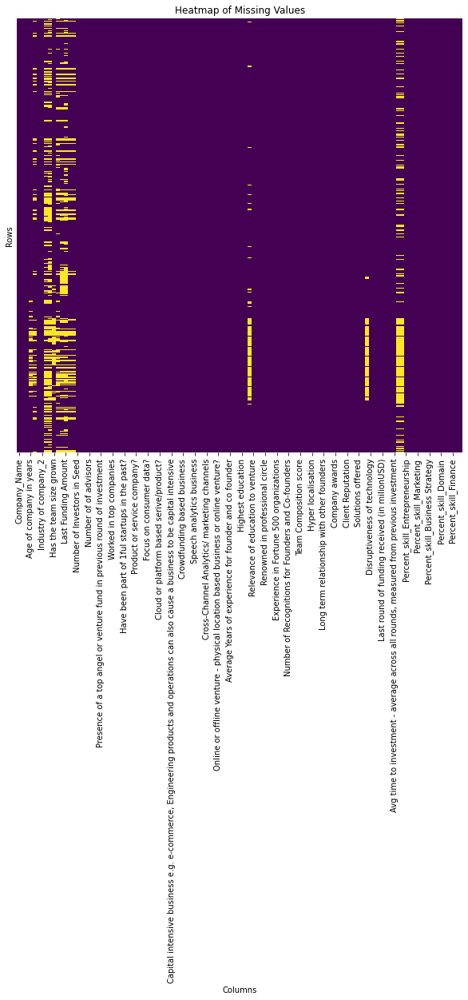

In [9]:
#Identify the distribution of missing values
missing_values_mask = df.isnull()
# Create a heatmap using seaborn to visualize missing values
plt.figure(figsize=(10, 10))
sns.heatmap(missing_values_mask, cbar=False, cmap='viridis', yticklabels=False)
plt.title('Heatmap of Missing Values')
plt.xlabel('Columns')
plt.ylabel('Rows')
plt.show()

In [10]:
# Count the number of duplicated rows
num_duplicates = df.duplicated().sum()
print("Number of duplicated rows:", num_duplicates)


Number of duplicated rows: 0


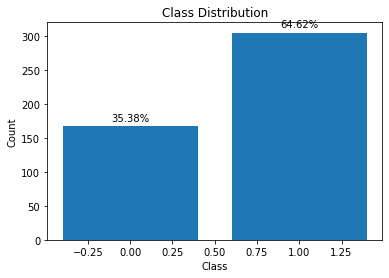

1    305
0    167
Name: Prediction, dtype: int64


In [11]:
#FOR OBSERVING THE CLASS DISTRIBUTION WITHIN THE DATASET
# Count the number of samples in each class
class_counts = df['Prediction'].value_counts()

# Calculate the percentage of each class
class_percentages = class_counts / class_counts.sum() * 100

# Create a bar chart to visualize the class distribution
fig, ax = plt.subplots()
bars = ax.bar(class_counts.index, class_counts.values)

# Add the percentage on top of each bar
for i, bar in enumerate(bars):
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height + 5,
            f'{class_percentages.iloc[i]:.2f}%', ha='center', va='bottom')

plt.title('Class Distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.show()
print(class_counts)


Drop Features 

In [12]:
#Drop redundant or meaningless features or ones with high proportion of missing values
df = df.drop(['Company_Name', 'year of founding', 'Employees count MoM change', 'Est. Founding Date', 'Last Funding Date'], axis=1)  # This will remove the "Company_Name" and "year of founding columns


In [13]:
# Check for missing values in each column
missing_values = df.isnull().any()

# Count the number of columns with missing values
num_columns_with_missing = missing_values.sum()

# Print the results
print("Number of columns with missing values:", num_columns_with_missing)
print("Columns with missing values:\n", missing_values)

# Check total number of missing values in the DataFrame
print("Total missing values:", df.isnull().sum().sum())
# Calculate the percentage of cells with missing values
percent_missing = df.isnull().sum().sum() / df.size * 100
print("Percentage of cells with missing values:", percent_missing)

Number of columns with missing values: 11
Columns with missing values:
 Prediction                  False
Age of company in years      True
Internet Activity Score      True
Industry of company_1       False
Industry of company_2       False
                            ...  
Percent_skill_Law           False
Percent_skill_Consulting    False
Percent_skill_Finance       False
Percent_skill_Investment    False
Renown score                False
Length: 109, dtype: bool
Total missing values: 1150
Percentage of cells with missing values: 2.235266677033121


FEATURE ENGINEERING

In [14]:
# Mapping and Encoding the Industry columns

industry_mapping = {0: 'Unknown', 1: 'AI', 2: 'Agriculture', 3: 'Analytics', 4: 'Big Data', 5: 'Children', 
                    6: 'Cloud Computing', 7: 'Customer Service', 8: 'Deal', 9: 'E-Commerce', 10: 'Education', 
                    11: 'Email', 12: 'Energy', 13: 'Enterprise Software', 14: 'Entertainment', 15: 'Finance', 
                    16: 'Gaming', 17: 'Government', 18: 'Healthcare', 19: 'Hospitality', 20: 'Hosting', 
                    21: 'Human Resources (HR)', 22: 'Market Research', 23: 'Marketing', 24: 'Media', 25: 'Mobile',
                    26: 'Music', 27: 'Platform', 28: 'Real Estate', 29: 'Retail', 30: 'Search', 31: 'Security', 
                    32: 'Social', 33: 'Software Development', 34: 'Sport', 35: 'Telecommunications', 36: 'Transportation'}

df['Industry of company_1'] = df['Industry of company_1'].map(industry_mapping)
df['Industry of company_2'] = df['Industry of company_2'].map(industry_mapping)

# Applying one-hot encoding separately on each 'Industry' column
encoded_company_1 = pd.get_dummies(df['Industry of company_1'], prefix='Industry_1')
encoded_company_2 = pd.get_dummies(df['Industry of company_2'], prefix='Industry_2')

# Concatenate the original dataframe with the encoded_company dataframes
df = pd.concat([df, encoded_company_1, encoded_company_2], axis=1)

# Drop the original 'Industry of company_1' and 'Industry of company_2' columns
df = df.drop(['Industry of company_1', 'Industry of company_2'], axis=1)


In [15]:
# Checking for missing values in each column
missing_values = df.isnull().any()

# Count the number of columns with missing values
num_columns_with_missing = missing_values.sum()

# Print the results
print("Number of columns with missing values:", num_columns_with_missing)
print("Columns with missing values:\n", missing_values)

# Check total number of missing values in the DataFrame
print("Total missing values:", df.isnull().sum().sum())
# Calculate the percentage of cells with missing values
percent_missing = df.isnull().sum().sum() / df.size * 100
print("Percentage of cells with missing values:", percent_missing)

Number of columns with missing values: 11
Columns with missing values:
 Prediction                         False
Age of company in years             True
Internet Activity Score             True
Employee Count                      True
Has the team size grown             True
                                   ...  
Industry_1_Software Development    False
Industry_1_Sport                   False
Industry_1_Telecommunications      False
Industry_1_Transportation          False
Industry_1_Unknown                 False
Length: 140, dtype: bool
Total missing values: 1150
Percentage of cells with missing values: 1.740314769975787


In [16]:
print(df.columns.tolist())


['Prediction', 'Age of company in years', 'Internet Activity Score', 'Employee Count', 'Has the team size grown', 'Last Funding Amount', 'Country of company', 'Continent of company', 'Number of Investors in Seed', 'Number of Investors in Angel and or VC', 'Number of Co-founders', 'Number of of advisors', 'Team size Senior leadership', 'Team size all employees', 'Presence of a top angel or venture fund in previous round of investment', 'Number of of repeat investors', 'Number of  Sales Support material', 'Worked in top companies', 'Average size of companies worked for in the past', 'Have been part of startups in the past?', 'Have been part of 1ful startups in the past?', 'Was he or she partner in Big 5 consulting?', 'Consulting experience?', 'Product or service company?', 'Catering to product/service across verticals', 'Focus on private or public data?', 'Focus on consumer data?', 'Focus on structured or unstructured data', 'Subscription based business', 'Cloud or platform based serive/

Feature Encoding

In [17]:
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder

# Define the columns for one-hot encoding and ordinal encoding
one_hot_cols = ['Has the team size grown', 'Presence of a top angel or venture fund in previous round of investment', 'Worked in top companies', 'Have been part of startups in the past?', 'Have been part of 1ful startups in the past?', 'Product or service company?', 'Was he or she partner in Big 5 consulting?', 'Consulting experience?', 'Continent of company', 'Country of company', 'Catering to product/service across verticals',     
                'Focus on private or public data?', 'Focus on consumer data?',   
                'Focus on structured or unstructured data', 'Subscription based business', 
                'Cloud or platform based serive/product?', 'Local or global player', 
                'Linear or Non-linear business model', 
                'Capital intensive business e.g. e-commerce, Engineering products and operations can also cause a business to be capital intensive',
                'Crowdsourcing based business', 'Crowdfunding based business', 'Machine Learning based business',
                'Predictive Analytics business', 'Speech analytics business', 
                'Prescriptive analytics business', 'Big Data Business', 
                'Owns data or not? (monetization of data) e.g. Factual', 'Hyper localisation', 'Long term relationship with other founders',
                'Is the company an aggregator/market place? e.g. Bluekai', 'Relevance of education to venture', 'Relevance of experience to venture',
                'Online or offline venture - physical location based business or online venture?','Exposure across the globe',
                'B2C or B2B venture?', 'Degree from a Tier 1 or Tier 2 university?', 'Barriers of entry for the competitors',
                'Pricing Strategy', 'Proprietary or patent position (competitive position)','Solutions offered', 'Specialization of highest education',
                'Controversial history of founder or co founder','Catering to product/service across verticals',
                'Legal risk and intellectual property', 'Invested through global incubation competitions?', 'Cross-Channel Analytics/ marketing channels',
                'Survival through recession, based on existence of the company through recession times',
                'Gartner hype cycle stage', 'Technical proficiencies to analyse and interpret unstructured data']

ordinal_cols = ['Average size of companies worked for in the past', 'Top management similarity', 'Experience in selling and building products', 
                'Number of  of Partners of company', 'Average Years of experience for founder and co founder', 'Breadth of experience across verticals',  
                'Highest education', 'Time to maturity of technology (in years)','Number of  of Research publications', 'Team Composition score', 'Dificulty of Obtaining Work force',
                'Time to market service or product', "Top forums like 'Tech crunch' or 'Venture beat' talking about the company/model - How much is it being talked about?",
                'Employee benefits and salary structures', 'Disruptiveness of technology', 'Number of  Sales Support material',
                'Client Reputation' 
                ]

# Create the encoders
one_hot_encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')
ordinal_encoder = OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1)

# Apply one-hot encoding
one_hot_encoded = one_hot_encoder.fit_transform(df[one_hot_cols])
one_hot_encoded_df = pd.DataFrame(one_hot_encoded, columns = one_hot_encoder.get_feature_names_out(one_hot_cols))

# Apply ordinal encoding
ordinal_encoded = ordinal_encoder.fit_transform(df[ordinal_cols])
ordinal_encoded_df = pd.DataFrame(ordinal_encoded, columns = ordinal_cols)

# Concatenate the encoded dataframes with the original dataframe
df_encoded = pd.concat([df, one_hot_encoded_df, ordinal_encoded_df], axis=1)

# Drop the original columns as they are now encoded
df_encoded = df_encoded.drop(columns=one_hot_cols)

df= df_encoded


In [18]:
column_names = df.columns.tolist()

print(column_names)

['Prediction', 'Age of company in years', 'Internet Activity Score', 'Employee Count', 'Last Funding Amount', 'Number of Investors in Seed', 'Number of Investors in Angel and or VC', 'Number of Co-founders', 'Number of of advisors', 'Team size Senior leadership', 'Team size all employees', 'Number of of repeat investors', 'Number of  Sales Support material', 'Average size of companies worked for in the past', 'Number of  of Partners of company', "Top forums like 'Tech crunch' or 'Venture beat' talking about the company/model - How much is it being talked about?", 'Average Years of experience for founder and co founder', 'Breadth of experience across verticals', 'Highest education', 'Years of education', 'Renowned in professional circle', 'Experience in selling and building products', 'Experience in Fortune 100 organizations', 'Experience in Fortune 500 organizations', 'Experience in Fortune 1000 organizations', 'Top management similarity', 'Number of Recognitions for Founders and Co-fo

In [19]:
# Find columns that contain "No Info" in their names
columns_to_drop = [col for col in df.columns if any(substring in col for substring in ["No Info" or "No  Info"])]

# Drop these columns
df_dropped = df.drop(columns=columns_to_drop)

# Print the names of the dropped columns
print("Columns Dropped:", columns_to_drop)


Columns Dropped: ['Has the team size grown_No Info', 'Presence of a top angel or venture fund in previous round of investment_No Info', 'Worked in top companies_No Info', 'Have been part of startups in the past?_No Info', 'Have been part of 1ful startups in the past?_No Info', 'Product or service company?_No Info', 'Was he or she partner in Big 5 consulting?_No Info', 'Consulting experience?_No Info', 'Catering to product/service across verticals_No Info', 'Focus on private or public data?_No Info', 'Focus on consumer data?_No Info', 'Focus on structured or unstructured data_No Info', 'Subscription based business_No Info', 'Cloud or platform based serive/product?_No Info', 'Local or global player_No Info', 'Linear or Non-linear business model_No Info', 'Capital intensive business e.g. e-commerce, Engineering products and operations can also cause a business to be capital intensive_No Info', 'Crowdsourcing based business_No Info', 'Crowdfunding based business_No Info', 'Machine Learning

In [20]:
# Check for missing values in each column
missing_values = df.isnull().any()

# Count the number of columns with missing values
num_columns_with_missing = missing_values.sum()

# Print the results
print("Number of columns with missing values:", num_columns_with_missing)
print("Columns with missing values:\n", missing_values)

# Check total number of missing values in the DataFrame
print("Total missing values:", df.isnull().sum().sum())
# Calculate the percentage of cells with missing values
percent_missing = df.isnull().sum().sum() / df.size * 100
print("Percentage of cells with missing values:", percent_missing)

Number of columns with missing values: 7
Columns with missing values:
 Prediction                                                                                                              False
Age of company in years                                                                                                  True
Internet Activity Score                                                                                                  True
Employee Count                                                                                                           True
Last Funding Amount                                                                                                      True
                                                                                                                        ...  
Top forums like 'Tech crunch' or 'Venture beat' talking about the company/model - How much is it being talked about?    False
Employee benefits and salary structures        

In [21]:
#Get the percentage missing value to determine if feeature should be kept or removed

missing_values_count = df.isnull().sum() # Get the number of missing values in each column

columns_with_missing_values = missing_values_count[missing_values_count > 0] # Get the columns with missing values

missing_values_percentage = (df.isnull().sum() / df.shape[0]) * 100 # Get the percentage of missing values in each column

percentage_with_missing_values = missing_values_percentage[missing_values_percentage > 0] # Get the percentage for columns with missing values

# Print columns with missing values and corresponding number and percentage of missing values
for column in columns_with_missing_values.index:
    print(f"Column: {column}")
    print(f"Number of missing values: {columns_with_missing_values[column]}")
    print(f"Percentage of missing values: {percentage_with_missing_values[column]}%")
    print("-"*50)

Column: Age of company in years
Number of missing values: 44
Percentage of missing values: 9.322033898305085%
--------------------------------------------------
Column: Internet Activity Score
Number of missing values: 65
Percentage of missing values: 13.771186440677965%
--------------------------------------------------
Column: Employee Count
Number of missing values: 166
Percentage of missing values: 35.16949152542373%
--------------------------------------------------
Column: Last Funding Amount
Number of missing values: 160
Percentage of missing values: 33.89830508474576%
--------------------------------------------------
Column: Industry trend in investing
Number of missing values: 82
Percentage of missing values: 17.372881355932204%
--------------------------------------------------
Column: Time to maturity of technology (in years)
Number of missing values: Time to maturity of technology (in years)    172
Time to maturity of technology (in years)    172
dtype: int64
Percentage of

In [22]:

df.replace(["No Info", "Not available"], np.nan, inplace=True) # Replaces "No Info" and "Not available" with NaN

# Convert columns to numeric 
df = df.apply(pd.to_numeric, errors='coerce') # errors='coerce' is used to set values that can't be converted to NaN

In [23]:
# Check for missing values in each column
missing_values = df.isnull().any()

# Count the number of columns with missing values
num_columns_with_missing = missing_values.sum()

# Print the results
print("Number of columns with missing values:", num_columns_with_missing)
print("Columns with missing values:\n", missing_values)

# Check total number of missing values in the DataFrame
print("Total missing values:", df.isnull().sum().sum())
# Calculate the percentage of cells with missing values
percent_missing = df.isnull().sum().sum() / df.size * 100
print("Percentage of cells with missing values:", percent_missing)

Number of columns with missing values: 56
Columns with missing values:
 Prediction                                                                                                              False
Age of company in years                                                                                                  True
Internet Activity Score                                                                                                  True
Employee Count                                                                                                           True
Last Funding Amount                                                                                                      True
                                                                                                                        ...  
Top forums like 'Tech crunch' or 'Venture beat' talking about the company/model - How much is it being talked about?    False
Employee benefits and salary structures       

In [24]:
print(df.dtypes)

Prediction                                                                                                                int64
Age of company in years                                                                                                 float64
Internet Activity Score                                                                                                 float64
Employee Count                                                                                                          float64
Last Funding Amount                                                                                                     float64
                                                                                                                         ...   
Top forums like 'Tech crunch' or 'Venture beat' talking about the company/model - How much is it being talked about?    float64
Employee benefits and salary structures                                                                 

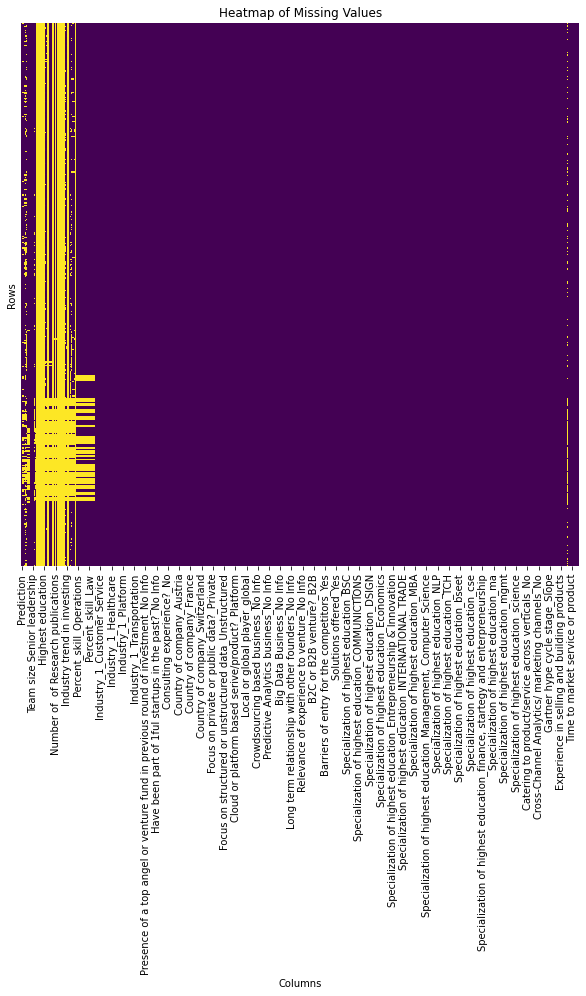

In [25]:

missing_values_mask = df.isnull()
# Create a heatmap using seaborn to visualize missing values
plt.figure(figsize=(10, 10))
sns.heatmap(missing_values_mask, cbar=False, cmap='viridis', yticklabels=False)
plt.title('Heatmap of Missing Values')
plt.xlabel('Columns')
plt.ylabel('Rows')
plt.show()

In [26]:

# Check for missing values in each column
missing_values = df.isnull().any()

# Count the number of columns with missing values
num_columns_with_missing = missing_values.sum()

# Print the results
print("Number of columns with missing values:", num_columns_with_missing)
print("Columns with missing values:\n", missing_values)

# Check total number of missing values 
print("Total missing values:", df.isnull().sum().sum())
# Calculate the percentage of cells with missing values
percent_missing = df.isnull().sum().sum() / df.size * 100
print("Percentage of cells with missing values:", percent_missing)


Number of columns with missing values: 56
Columns with missing values:
 Prediction                                                                                                              False
Age of company in years                                                                                                  True
Internet Activity Score                                                                                                  True
Employee Count                                                                                                           True
Last Funding Amount                                                                                                      True
                                                                                                                        ...  
Top forums like 'Tech crunch' or 'Venture beat' talking about the company/model - How much is it being talked about?    False
Employee benefits and salary structures       

In [27]:

missing_values_count = df.isnull().sum() # Get the number of missing values in each column

columns_with_missing_values = missing_values_count[missing_values_count > 0] # Get the columns with missing values

missing_values_percentage = (df.isnull().sum() / df.shape[0]) * 100 # Get the percentage of missing values in each column


percentage_with_missing_values = missing_values_percentage[missing_values_percentage > 0] # Get the percentage for columns with missing values

# Print columns with missing values and corresponding number and percentage of missing values
for column in columns_with_missing_values.index:
    print(f"Column: {column}")
    print(f"Number of missing values: {columns_with_missing_values[column]}")
    print(f"Percentage of missing values: {percentage_with_missing_values[column]}%")
    print("-"*50)

Column: Age of company in years
Number of missing values: 59
Percentage of missing values: 12.5%
--------------------------------------------------
Column: Internet Activity Score
Number of missing values: 65
Percentage of missing values: 13.771186440677965%
--------------------------------------------------
Column: Employee Count
Number of missing values: 166
Percentage of missing values: 35.16949152542373%
--------------------------------------------------
Column: Last Funding Amount
Number of missing values: 160
Percentage of missing values: 33.89830508474576%
--------------------------------------------------
Column: Number of Investors in Seed
Number of missing values: 49
Percentage of missing values: 10.38135593220339%
--------------------------------------------------
Column: Number of Investors in Angel and or VC
Number of missing values: 49
Percentage of missing values: 10.38135593220339%
--------------------------------------------------
Column: Team size all employees
Number

In [28]:

df['Number of Missing Values per Company'] = df.isna().sum(axis=1) # Create a new column with the count of missing values for each row

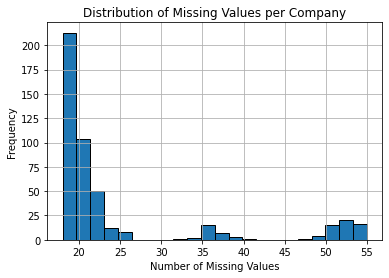

In [29]:
# Create a histogram of the 'Number of Missing Values per Company' column
plt.hist(df['Number of Missing Values per Company'], bins=22, edgecolor='black')
plt.title('Distribution of Missing Values per Company')
plt.xlabel('Number of Missing Values')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

In [30]:

# Identify duplicated rows
duplicate_rows = df[df.duplicated()]

# Group duplicated rows by class
grouped_duplicates = duplicate_rows.groupby("Prediction").size()

# Print the number of duplicated rows by class
print("Duplicated rows by Prediction:\n", grouped_duplicates)

Duplicated rows by Prediction:
 Prediction
0    1
1    1
dtype: int64


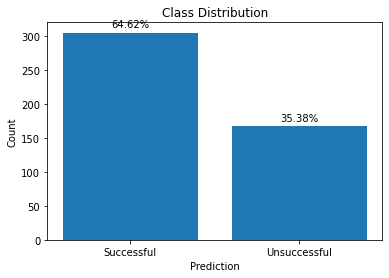

Successful      305
Unsuccessful    167
Name: Prediction, dtype: int64


In [31]:

df2 = df.copy() # Making a copy of the DataFrame

label_map = {1: 'Successful', 0: 'Unsuccessful'}

# Map the current class labels to "Successful" and "Unsuccessful"
df2['Prediction'] = df2['Prediction'].map(label_map)

# Count the number of samples in each class
class_counts = df2['Prediction'].value_counts()

# Calculate the percentage of each class
class_percentages = class_counts / class_counts.sum() * 100

# Create a bar chart to visualize the class distribution
fig, ax = plt.subplots()
bars = ax.bar(class_counts.index, class_counts.values)

# Add the percentage on top of each bar
for i, bar in enumerate(bars):
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height + 5,
            f'{class_percentages.iloc[i]:.2f}%', ha='center', va='bottom')

plt.title('Class Distribution')
plt.xlabel('Prediction')
plt.ylabel('Count')
plt.show()

# Print the class counts
print(class_counts)


In [32]:
df.shape

(472, 448)

In [33]:
columns_to_remove = [col for col in df.columns if "_No Info" in col or "_nan" in col or col == "Number of Missing Values per Company" or col == "Last round of funding received (in milionUSD)" or col == 'Team size all employees'] 
# Drop those columns
df.drop(columns=columns_to_remove, inplace=True)

# Print the number of columns removed
num_removed = len(columns_to_remove)
print(f'Number of features removed: {num_removed}')

Number of features removed: 53


In [34]:
num_removed = df.columns.duplicated().sum()
df = df.loc[:, ~df.columns.duplicated()]

print(f'Number of columns removed: {num_removed}')

Number of columns removed: 19


In [35]:
df.shape

(472, 376)

In [36]:
column_names = df.columns.tolist()

print(column_names)

['Prediction', 'Age of company in years', 'Internet Activity Score', 'Employee Count', 'Last Funding Amount', 'Number of Investors in Seed', 'Number of Investors in Angel and or VC', 'Number of Co-founders', 'Number of of advisors', 'Team size Senior leadership', 'Number of of repeat investors', 'Number of  Sales Support material', 'Average size of companies worked for in the past', 'Number of  of Partners of company', "Top forums like 'Tech crunch' or 'Venture beat' talking about the company/model - How much is it being talked about?", 'Average Years of experience for founder and co founder', 'Breadth of experience across verticals', 'Highest education', 'Years of education', 'Renowned in professional circle', 'Experience in selling and building products', 'Experience in Fortune 100 organizations', 'Experience in Fortune 500 organizations', 'Experience in Fortune 1000 organizations', 'Top management similarity', 'Number of Recognitions for Founders and Co-founders', 'Number of  of Res

In [37]:
#identifying columns with only Nan values
nan_columns = [col for col in df.columns if df[col].isnull().all()]

if nan_columns:
    print("Columns with only NaN values:")
    for col in nan_columns:
        print(col)
else:
    print("No columns consist of NaN values only.")


Columns with only NaN values:
Number of  Sales Support material
Average size of companies worked for in the past
Number of  of Partners of company
Top forums like 'Tech crunch' or 'Venture beat' talking about the company/model - How much is it being talked about?
Average Years of experience for founder and co founder
Breadth of experience across verticals
Highest education
Experience in selling and building products
Top management similarity
Number of  of Research publications
Team Composition score
Dificulty of Obtaining Work force
Time to market service or product
Employee benefits and salary structures
Company awards
Client Reputation
Disruptiveness of technology
Time to maturity of technology (in years)


In [38]:
# Removing the columns with only NaN values
nan_columns = [col for col in df.columns if df[col].isnull().all()]

# Drop the columns from the DataFrame
if nan_columns:
    df = df.drop(columns=nan_columns)
    print(f"Removed {len(nan_columns)} columns with only NaN values.")
else:
    print("No columns with only NaN values found.")


Removed 18 columns with only NaN values.


In [39]:

# Convert all string values to either float or int where possible
df = df.applymap(lambda x: pd.to_numeric(x, errors='ignore'))

#print(df)


DOWNLOAD FOR CREATING SYNTHETHIC DATASET

In [40]:
#Download to create synthethic dataset
#df.to_csv('C:/Users/ramsa/Documents/Python Bootcamp/startupdatanew.csv', index=False)


In [41]:
df.describe()

,Prediction,Age of company in years,Internet Activity Score,Employee Count,Last Funding Amount,Number of Investors in Seed,Number of Investors in Angel and or VC,Number of Co-founders,Number of of advisors,Team size Senior leadership,...,"Survival through recession, based on existence of the company through recession times_No","Survival through recession, based on existence of the company through recession times_Not Applicable","Survival through recession, based on existence of the company through recession times_Yes",Gartner hype cycle stage_Peak,Gartner hype cycle stage_Plateau,Gartner hype cycle stage_Slope,Gartner hype cycle stage_Trigger,Gartner hype cycle stage_Trough,Technical proficiencies to analyse and interpret unstructured data_No,Technical proficiencies to analyse and interpret unstructured data_Yes
count,472.000000,413.000000,407.000000,306.000000,3.120000e+02,423.000000,423.000000,472.000000,472.000000,472.000000,...,472.000000,472.000000,472.000000,472.000000,472.000000,472.000000,472.000000,472.000000,472.000000,472.000000
mean,0.646186,4.605327,114.159705,31.408497,6.379489e+06,1.546099,0.576832,1.868644,1.016949,3.730932,...,0.065678,0.567797,0.158898,0.163136,0.180085,0.050847,0.141949,0.099576,0.457627,0.366525
std,0.478660,2.607247,225.651419,62.673600,9.901622e+06,2.959782,1.396723,1.143481,2.014736,2.516539,...,0.247981,0.495908,0.365969,0.369881,0.384666,0.219919,0.349368,0.299752,0.498730,0.482367
min,0.000000,1.000000,-725.000000,0.000000,1.000000e+04,0.000000,0.000000,0.000000,0.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,3.000000,-3.500000,4.250000,7.500000e+05,0.000000,0.000000,1.000000,0.000000,2.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,4.000000,60.000000,13.000000,2.800000e+06,0.000000,0.000000,2.000000,0.000000,3.000000,...,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,6.000000,216.000000,31.000000,7.850000e+06,2.000000,0.000000,2.250000,1.000000,5.000000,...,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
max,1.000000,17.000000,1535.000000,594.000000,7.700000e+07,24.000000,9.000000,7.000000,13.000000,24.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


Datasplitting

Split dataframe into train, validation and test split in the ratio 80/20

In [42]:
from sklearn.model_selection import train_test_split

# Separation of features and target variable
X = df.drop('Prediction', axis=1)
Y = df['Prediction']

# Splitting of data into training, validation, and test sets while preserving class distribution
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)




In [43]:

# Concatenate features and target variable back into dataframes
train_df = pd.concat([X_train, Y_train], axis=1)
test_df = pd.concat([X_test, Y_test], axis=1)

# Making copies for outlier transformation
train_df_clean = train_df.copy()
test_df_clean = test_df.copy()

# Transform outliers using the 1st and 99th percentile values
train_q01 = train_df_clean.quantile(0.01)
train_q99 = train_df_clean.quantile(0.99)

# Applying outlier transformation
train_df_clean = train_df_clean.mask(train_df_clean < train_q01, train_q01, axis=1)
train_df_clean = train_df_clean.mask(train_df_clean > train_q99, train_q99, axis=1)
test_df_clean = test_df_clean.mask(test_df_clean < train_q01, train_q01, axis=1)
test_df_clean = test_df_clean.mask(test_df_clean > train_q99, train_q99, axis=1)

# Convert all columns to numeric data type
train_df_clean = train_df_clean.apply(pd.to_numeric, errors='coerce')
test_df_clean = test_df_clean.apply(pd.to_numeric, errors='coerce')


In [44]:
train_df_clean.shape

(377, 358)

from sklearn.impute import SimpleImputer

# Separate features from the cleaned training and testing sets
X_train_clean = train_df_clean.drop("Prediction", axis=1) 
X_test_clean = test_df_clean.drop("Prediction", axis=1)

# Impute missing values using mean imputation
imputer = SimpleImputer(strategy='median')
X_train_imputed = imputer.fit_transform(X_train_clean)
X_test_imputed = imputer.transform(X_test_clean)

# Convert back to DataFrame to maintain column names
X_train_imputed = pd.DataFrame(X_train_imputed, columns=X_train_clean.columns)
X_test_imputed = pd.DataFrame(X_test_imputed, columns=X_test_clean.columns)

In [45]:
from sklearn.impute import KNNImputer

# Separate features from the cleaned training and testing sets
X_train_clean = train_df_clean.drop("Prediction", axis=1) 
X_test_clean = test_df_clean.drop("Prediction", axis=1)

# Impute missing values using KNN imputation
imputer = KNNImputer(n_neighbors=3)
X_train_imputed = imputer.fit_transform(X_train_clean)
X_test_imputed = imputer.transform(X_test_clean)

# Convert back to DataFrame to maintain column names
X_train_imputed = pd.DataFrame(X_train_imputed, columns=X_train_clean.columns)
X_test_imputed = pd.DataFrame(X_test_imputed, columns=X_test_clean.columns)


In [46]:
X_train_scaled = X_train_imputed
X_test_scaled = X_test_imputed 

from imblearn.over_sampling import ADASYN
ada = ADASYN(random_state=42) # Apply ADASYN SMOTE for oversampling to the training set only
X_train_resampled, Y_train_resampled = ada.fit_resample(X_train_scaled, Y_train)

from collections import Counter
# Counts samples in the original and resampled datasets
print("Original dataset shape:", Counter(Y_train))
print("Resampled dataset shape:", Counter(Y_train_resampled))


from imblearn.over_sampling import SMOTE
from collections import Counter
smote = SMOTE(random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train_scaled, Y_train)

# Checking the distribution of the target variable
print("Original dataset shape:", Counter(Y_train))
print("Resampled dataset shape:", Counter(Y_train_resampled))


from imblearn.under_sampling import RandomUnderSampler
from collections import Counter

rus = RandomUnderSampler(random_state=42)
X_train_resampled, Y_train_resampled = rus.fit_resample(X_train_scaled, Y_train)

# Checking the distribution of the target variable
print("Original dataset shape:", Counter(Y_train))
print("Resampled dataset shape:", Counter(Y_train_resampled))


#Using Recursive Feature Eliminator

from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

# Initialize the model
model = LogisticRegression(solver='lbfgs', max_iter=10000)

# Initialize RFE
selector = RFE(model, n_features_to_select=20, step=1) 

# Fit RFE
selector = selector.fit(X_train_resampled, Y_train_resampled)

# Get selected features
selected_features = X_train_resampled.columns[selector.support_]

# Transform the datasets to include only the selected features
X_train_selected = selector.transform(X_train_resampled)
X_test_selected = selector.transform(X_test_scaled)
print(selector.estimator_.solver)

#Using Recursive Feature Eliminator

from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

# Initialize the model with default hyperparameters
model = LogisticRegression()

# Initialize RFE
selector = RFE(model, n_features_to_select=15, step=1) 

# Fit RFE
selector = selector.fit(X_train_resampled, Y_train_resampled)

# Get selected features
selected_features = X_train_resampled.columns[selector.support_]

# Transform the datasets to include only the selected features
X_train_selected = selector.transform(X_train_resampled)
X_test_selected = selector.transform(X_test_scaled)
print(selector.estimator_.solver)


# Using Recursive Feature Eliminator

from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

# Initialize the model with custom hyperparameters
model = LogisticRegression(
    penalty='l2',        # Regularization penalty: 'l1', 'l2', 'elasticnet', or 'none'
    C=1.0,               # Inverse of regularization strength; must be a positive float (smaller values specify stronger regularization)
    solver='lbfgs',      # Algorithm to use in the optimization problem: 'newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'
    max_iter=100,        # Maximum number of iterations taken for the solvers to converge
    random_state=42      # Seed used by the random number generator
)

# Initialize RFE
selector = RFE(model, n_features_to_select=15, step=1) 

# Fit RFE
selector = selector.fit(X_train_resampled, Y_train_resampled)

# Get selected features
selected_features = X_train_resampled.columns[selector.support_]

# Transform the datasets to include only the selected features
X_train_selected = selector.transform(X_train_resampled)
X_test_selected = selector.transform(X_test_scaled)
print(selector.estimator_.solver)


from sklearn.metrics import roc_auc_score
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
import numpy as np

# Initialize a list to store the AUC scores at each step
auc_scores = []

# Start with no features and add one feature at a time
for i in range(X_train_resampled.shape[1]):
    
    # Get the features to be used in this iteration
    features_to_use = X_train_resampled.columns[:i+1]
    
    # Get the training data for this iteration
    X_train_iteration = X_train_resampled[features_to_use]
    
    # Initialize and train the model using cross-validation
    model = LogisticRegression(random_state=42)
    cv_scores = cross_val_score(model, X_train_iteration, Y_train_resampled, cv=5, scoring='roc_auc')
    
    # Get the mean AUC score across all folds
    mean_auc = np.mean(cv_scores)
    
    # Store the AUC score
    auc_scores.append(mean_auc)
    
    # Print the AUC score for this iteration
    print(f'Number of features: {i+1}, AUC score: {mean_auc:.3f}')

# Plot the AUC scores
plt.plot(range(1, X_train_resampled.shape[1]+1), auc_scores)
plt.xlabel('Number of Features')
plt.ylabel('AUC Score')
plt.title('AUC Score vs Number of Features')
plt.show()


from sklearn.linear_model import LogisticRegression

# Initialize the model with L1 (Lasso) regularization
model = LogisticRegression(penalty='l2', solver='lbfgs', random_state=42)

# Fit the model
model.fit(X_train_resampled, Y_train_resampled)

# Get the coefficients of the features
coefficients = model.coef_[0]

# Identify non-zero coefficients (i.e., selected features)
selected_features = X_train_resampled.columns[coefficients != 0]
#print("Selected features:", selected_features.tolist())

from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier

rf_clf = RandomForestClassifier(random_state=42)
selector = RFE(rf_clf, n_features_to_select=20)
selector = selector.fit(X_train_resampled, Y_train_resampled)


print("Number of selected features:", len(selected_features))


#Model Training
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score

# Create an instance of the RandomForestClassifier class with a random state for reproducibility
rf_clf = RandomForestClassifier(random_state=42)

# Fit the random forest classifier to your resampled training data
rf_clf.fit(X_train_resampled, Y_train_resampled)



from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier

# Step 1: Feature Selection using RFE
#rf_clf = RandomForestClassifier(random_state=42)
#selector = RFE(rf_clf, n_features_to_select=20)
#selector = selector.fit(X_train_scaled, Y_train)

# Getting the selected features
#X_train_selected = selector.transform(X_train_scaled)

# Step 2: Model Training with Selected Features
# Create an instance of the RandomForestClassifier class with a random state for reproducibility
rf_clf = RandomForestClassifier(random_state=42)

# Fit the random forest classifier to the training data using only the selected features
rf_clf.fit(X_train_scaled, Y_train)


#Model Evaluation
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, roc_auc_score

#model.fit(X_train_resampled[selected_features], Y_train_resampled)
# Predict on the test data
#Y_pred = selector.predict(X_test_scaled)
Y_pred = rf_clf.predict(X_test_scaled)

# Calculate metrics
accuracy = accuracy_score(Y_pred, Y_test)
precision = precision_score(Y_pred, Y_test)
recall = recall_score(Y_pred, Y_test)
f1 = f1_score(Y_pred, Y_test)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")

# Confusion Matrix
cm = confusion_matrix(Y_pred, Y_test)
print(f"Confusion Matrix:\n{cm}")

# ROC Curve
#Y_prob = model.predict_proba(X_test_selected)[:,1]
#Y_prob = selector.predict_proba(X_test_scaled)[:,1]
Y_prob = rf_clf.predict_proba(X_test_scaled)[:,1]

fpr, tpr, thresholds = roc_curve(Y_test, Y_prob)
plt.plot(fpr, tpr)
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

# ROC AUC Score
roc_auc = roc_auc_score(Y_test, Y_prob)
print(f"AUC ROC Score: {roc_auc}")


# Model Training
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score

# Initialize and fit the logistic regression model
log_reg = LogisticRegression(random_state=42, solver='lbfgs', max_iter=10000)
log_reg.fit(X_train_selected, Y_train_resampled)

# Perform 5-fold cross-validation using the selected features
cv_scores = cross_val_score(log_reg, X_train_selected, Y_train_resampled, cv=5, scoring='roc_auc')

# Print the AUC ROC scores obtained from the cross-validation
print("AUC ROC Scores for each fold: ", cv_scores)
print("Mean AUC ROC Score: ", cv_scores.mean())
print("Standard Deviation of AUC ROC Scores: ", cv_scores.std())


from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from sklearn.model_selection import cross_val_score
import numpy as np

# Step 1: Initial Feature Selection using Lasso Regularization
lasso_model = LogisticRegression(penalty='l2', solver='lbfgs', random_state=42)
lasso_model.fit(X_train_resampled, Y_train_resampled)
coefficients = lasso_model.coef_[0]
lasso_selected_features = X_train_resampled.columns[np.nonzero(coefficients)]

# Step 2: Refined Feature Selection using RFE
# Using the features selected by Lasso as an input to RFE
model_for_rfe = LogisticRegression(random_state=42)
selector = RFE(model_for_rfe, n_features_to_select=20, step=1)
selector = selector.fit(X_train_resampled[lasso_selected_features], Y_train_resampled)
rfe_selected_features = lasso_selected_features[selector.support_]

# Step 3: Model Training using the Features Selected by RFE
# Creating new training and test sets with only the selected features
X_train_selected = X_train_resampled[rfe_selected_features]
X_test_selected = X_test_scaled[rfe_selected_features]

# Training a logistic regression model using the selected features
log_reg = LogisticRegression(random_state=42)
log_reg.fit(X_train_selected, Y_train_resampled)
print("Number of selected features:", len(rfe_selected_features))

from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from sklearn.model_selection import GridSearchCV, cross_val_score

# Step 1: Feature selection using RFE with default hyperparameters
selector = RFE(estimator=LogisticRegression(random_state=42), n_features_to_select=20)
selector = selector.fit(X_train_resampled, Y_train_resampled)
selected_features = X_train_resampled.columns[selector.support_]

# Prepare X_test_selected using the features selected by RFE
X_test_selected = X_test_scaled[selected_features]

# Step 2: Grid Search with 10-fold CV on selected features
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear','lbfgs','saga']
}
grid_search = GridSearchCV(LogisticRegression(random_state=42), param_grid, cv=10, scoring='roc_auc')
grid_search.fit(X_train_resampled[selected_features], Y_train_resampled)

# Print the best parameters and the best score
print('Best parameters:', grid_search.best_params_)
print('Best score:', grid_search.best_score_)


from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from sklearn.model_selection import cross_val_score, LeaveOneOut

# Step 1: Feature selection using RFE with default hyperparameters
selector = RFE(estimator=LogisticRegression(random_state=42), n_features_to_select=20)
selector = selector.fit(X_train_resampled, Y_train_resampled)
selected_features = X_train_resampled.columns[selector.support_]

# Prepare X_test_selected using the features selected by RFE
X_test_selected = X_test_scaled[selected_features]

# Step 2: LOOCV with default hyperparameters on selected features
loocv = LeaveOneOut()
model = LogisticRegression(random_state=42)

# Use cross_val_score to perform LOOCV
scores = cross_val_score(model, X_train_resampled[selected_features], Y_train_resampled, cv=loocv, scoring='accuracy')

# Print the mean and standard deviation of the scores
print('Mean Accuracy:', scores.mean())
print('Standard Deviation of Accuracy:', scores.std())


from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from sklearn.model_selection import GridSearchCV, LeaveOneOut

# Step 1: Feature selection using RFE with default hyperparameters
selector = RFE(estimator=LogisticRegression(random_state=42), n_features_to_select=20)
selector = selector.fit(X_train_resampled, Y_train_resampled)
selected_features = X_train_resampled.columns[selector.support_]

# Prepare X_test_selected using the features selected by RFE
X_test_selected = X_test_scaled[selected_features]

# Step 2: Grid Search with LOOCV on selected features
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'lbfgs', 'saga']
}
grid_search = GridSearchCV(LogisticRegression(random_state=42), param_grid, cv=LeaveOneOut(), scoring='accuracy')
grid_search.fit(X_train_resampled[selected_features], Y_train_resampled)

# Print the best parameters and the best score
print('Best parameters:', grid_search.best_params_)
print('Best accuracy score:', grid_search.best_score_)


#Model Evaluation
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, roc_auc_score

#model.fit(X_train_resampled[selected_features], Y_train_resampled)
# Predict on the test data
Y_pred = grid_search.best_estimator_.predict(X_test_selected)
#Y_pred = model.predict(X_test_selected)

# Calculate metrics
accuracy = accuracy_score(Y_pred, Y_test)
precision = precision_score(Y_pred, Y_test)
recall = recall_score(Y_pred, Y_test)
f1 = f1_score(Y_pred, Y_test)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")

# Confusion Matrix
cm = confusion_matrix(Y_pred, Y_test)
print(f"Confusion Matrix:\n{cm}")

# ROC Curve
#Y_prob = model.predict_proba(X_test_selected)[:,1]
Y_prob = grid_search.best_estimator_.predict_proba(X_test_selected)[:,1]

fpr, tpr, thresholds = roc_curve(Y_test, Y_prob)
plt.plot(fpr, tpr)
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

# ROC AUC Score
roc_auc = roc_auc_score(Y_test, Y_prob)
print(f"AUC ROC Score: {roc_auc}")


cv_scores = cross_val_score(log_reg, X_train_selected, Y_train_resampled, cv=10, scoring='roc_auc')

# Print the cross-validation scores
print("Cross-validation ROC-AUC scores:", cv_scores)
print("Mean cross-validation ROC-AUC score:", cv_scores.mean())

# Step 1: Fit your logistic regression model using the selected features data
log_reg = LogisticRegression(random_state=42)
log_reg.fit(X_train_selected, Y_train_resampled)

# Step 2: Get the coefficients from the fitted model
feature_importance = log_reg.coef_[0]

# Now, you have the correct feature importances. You can proceed to create your feature importance DataFrame as you were doing before.
feature_names = selected_features  # you already have this from your RFE script
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importance})
print(feature_importance_df.sort_values(by='Importance', ascending=False))


import matplotlib.pyplot as plt

# Get the feature importances from the random forest model
feature_importances = rf_clf.feature_importances_

# Get the feature names from your training DataFrame
feature_names = X_train_scaled.columns

# Create a dictionary of feature names and their importance scores
features_importances = dict(zip(feature_names, feature_importances))


# Sort the features by importance
sorted_features = sorted(features_importances.items(), key=lambda x: x[1], reverse=True)

# Separate the feature names and importance values
sorted_feature_names, sorted_importances = zip(*sorted_features)

# Create a bar chart of the top 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[:20], sorted_importances[:20])
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Top 20 Features')
plt.gca().invert_yaxis() # This will display the bar with the highest importance at the top
plt.show()

# Create a bar chart of the bottom 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[-20:], sorted_importances[-20:])
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Bottom 20 Features')
plt.gca().invert_yaxis() # This will display the bar with the lowest importance at the top
plt.show()


# Print the top 20 features and their coefficients
print("Top 20 features:")
for feature, coef in sorted_features[:20]:
    print(f"{feature}: {coef}")

print("\n")

# Print the bottom 20 features and their coefficients
print("Bottom 20 features:")
for feature, coef in sorted_features[-20:]:
    print(f"{feature}: {coef}")


import matplotlib.pyplot as plt

# Get the feature importances from the random forest model
feature_importances = rf_clf.feature_importances_

# Get the feature names from your training DataFrame
feature_names = X_train_scaled.columns

# Get the names of the selected features
selected_feature_names = feature_names[selector.support_]

# Create a dictionary of selected feature names and their importance scores
selected_features_importances = dict(zip(selected_feature_names, feature_importances))

# Sort the selected features by importance
sorted_features = sorted(selected_features_importances.items(), key=lambda x: x[1], reverse=True)

# Separate the feature names and importance values
sorted_feature_names, sorted_importances = zip(*sorted_features)

# Create a bar chart of the top 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names, sorted_importances)  # Display all 20 features
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Top 20 Features Selected by RFE')
plt.gca().invert_yaxis() # This will display the bar with the highest importance at the top
plt.show()


import matplotlib.pyplot as plt

# Get the coefficients of the features
coefficients = log_reg.coef_[0]

# Get the feature names
feature_names = X_train_resampled.columns

# Create a dictionary of feature names and their coefficient values
features_importances = dict(zip(feature_names, coefficients))

# Sort the features by importance
sorted_features = sorted(features_importances.items(), key=lambda x: x[1], reverse=True)

# Separate the feature names and coefficient values
sorted_feature_names, sorted_coefficients = zip(*sorted_features)

# Create a bar chart of the top 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[:20], sorted_coefficients[:20])
plt.xlabel('Coefficient Value')
plt.ylabel('Feature')
plt.title('Top 20 Features')
plt.gca().invert_yaxis() # This will display the bar with the highest coefficient at the top
plt.show()

# Create a bar chart of the bottom 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[-20:], sorted_coefficients[-20:])
plt.xlabel('Coefficient Value')
plt.ylabel('Feature')
plt.title('Bottom 20 Features')
plt.gca().invert_yaxis() # This will display the bar with the lowest coefficient at the top
plt.show()


# Print the top 20 features and their coefficients
print("Top 20 features:")
for feature, coef in sorted_features[:20]:
    print(f"{feature}: {coef}")

print("\n")

# Print the bottom 20 features and their coefficients
print("Bottom 20 features:")
for feature, coef in sorted_features[-20:]:
    print(f"{feature}: {coef}")


In [47]:
rf_clf = RandomForestClassifier(random_state=42)
rf_clf.fit(X_train_scaled, Y_train)


RandomForestClassifier(random_state=42)

In [48]:
feature_importances = rf_clf.feature_importances_


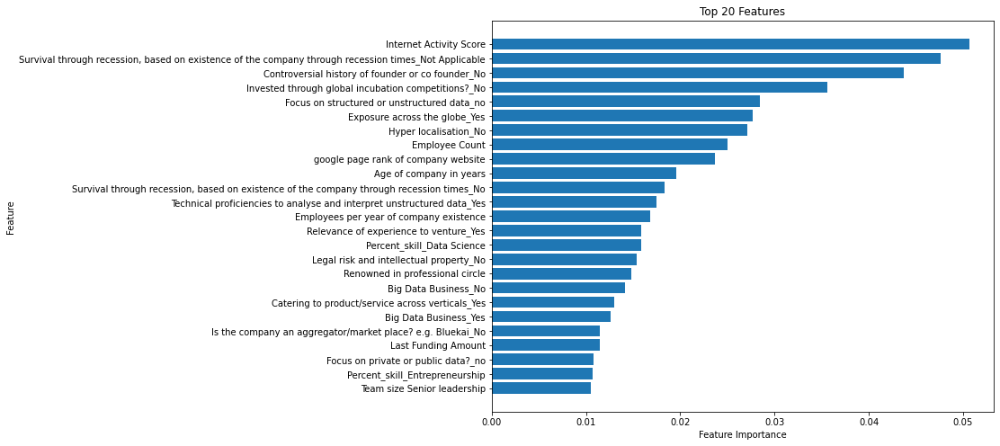

In [49]:
import matplotlib.pyplot as plt

# Get the feature importances from the random forest model
feature_importances = rf_clf.feature_importances_

# Get the feature names from your training DataFrame
feature_names = X_train_scaled.columns

# Create a dictionary of feature names and their importance scores
features_importances = dict(zip(feature_names, feature_importances))


# Sort the features by importance
sorted_features = sorted(features_importances.items(), key=lambda x: x[1], reverse=True)

# Separate the feature names and importance values
sorted_feature_names, sorted_importances = zip(*sorted_features)

# Create a bar chart of the top 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[:25], sorted_importances[:25])
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Top 20 Features')
plt.gca().invert_yaxis() # This will display the bar with the highest importance at the top
plt.show()



In [50]:
# Print the top 20 features and their coefficients
print("Top 25 features:")
for feature, coef in sorted_features[:25]:
    print(f"{feature}: {coef}")

print("\n")


Top 25 features:
Internet Activity Score: 0.05069895542369623
Survival through recession, based on existence of the company through recession times_Not Applicable: 0.047621574243861875
Controversial history of founder or co founder_No: 0.043695082231490365
Invested through global incubation competitions?_No: 0.035596906936993335
Focus on structured or unstructured data_no: 0.028431996234388603
Exposure across the globe_Yes: 0.027679360217187757
Hyper localisation_No: 0.027094329503294365
Employee Count: 0.025031298951297357
google page rank of company website: 0.023640341206159418
Age of company in years: 0.019538738606520546
Survival through recession, based on existence of the company through recession times_No: 0.01833599552184013
Technical proficiencies to analyse and interpret unstructured data_Yes: 0.017435426632477425
Employees per year of company existence: 0.016807198473493073
Relevance of experience to venture_Yes: 0.0158642711457427
Percent_skill_Data Science: 0.015830264582

In [51]:
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
rf_clf.fit(X_train_scaled, Y_train)


RandomForestClassifier(random_state=42)

In [52]:
from sklearn.model_selection import LeaveOneOut, cross_val_score

loo = LeaveOneOut()

cv_scores = cross_val_score(rf_clf, X_train_scaled, Y_train, cv=10, scoring='accuracy')

rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
rf_clf.fit(X_train_scaled, Y_train)

print("Cross-validation scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("Standard Deviation of CV scores:", cv_scores.std())

#print("Cross-validation scores:", cv_scores)
#print("Mean LOOCV Score (Accuracy):", cv_scores.mean())
#print("Standard Deviation of LOOCV scores:", cv_scores.std())

Cross-validation scores: [0.94736842 0.84210526 0.89473684 0.81578947 0.86842105 0.94736842
 0.92105263 0.94594595 0.94594595 0.86486486]
Mean CV Score: 0.8993598862019916
Standard Deviation of CV scores: 0.0467454084683349


Accuracy: 0.9263157894736842
Precision: 0.9836065573770492
Recall: 0.9090909090909091
F1 Score: 0.9448818897637795
Confusion Matrix:
[[28  1]
 [ 6 60]]


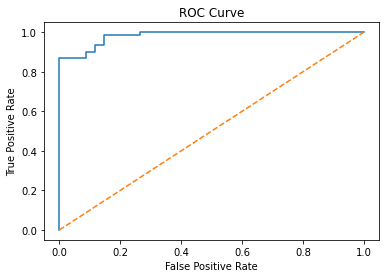

AUC ROC Score: 0.9816779170684667


In [53]:
#Model Evaluation
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, roc_auc_score

#model.fit(X_train_resampled[selected_features], Y_train_resampled)
# Predict on the test data
#Y_pred = selector.predict(X_test_scaled)
Y_pred = rf_clf.predict(X_test_scaled)

# Calculate metrics
accuracy = accuracy_score(Y_pred, Y_test)
precision = precision_score(Y_pred, Y_test)
recall = recall_score(Y_pred, Y_test)
f1 = f1_score(Y_pred, Y_test)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")

# Confusion Matrix
cm = confusion_matrix(Y_pred, Y_test)
print(f"Confusion Matrix:\n{cm}")

# ROC Curve
#Y_prob = model.predict_proba(X_test_selected)[:,1]
#Y_prob = selector.predict_proba(X_test_scaled)[:,1]
Y_prob = rf_clf.predict_proba(X_test_scaled)[:,1]

fpr, tpr, thresholds = roc_curve(Y_test, Y_prob)
plt.plot(fpr, tpr)
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

# ROC AUC Score
roc_auc = roc_auc_score(Y_test, Y_prob)
print(f"AUC ROC Score: {roc_auc}")


In [54]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier

from sklearn.model_selection import LeaveOneOut, cross_val_score

loo = LeaveOneOut()

# Define the parameter grid
param_grid = {
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4],
    'n_estimators': [100,200,500]
    
}

# Initialize the RandomForestClassifier
rf_clf = RandomForestClassifier(random_state=42)

# Initialize the GridSearchCV object
grid_search = GridSearchCV(rf_clf, param_grid, cv=10, scoring='accuracy', verbose=1, n_jobs=-1)

# Fit the GridSearchCV object to the data
grid_search.fit(X_train_scaled, Y_train)

# Print the best parameters and their corresponding accuracy score
print("Best parameters found: ", grid_search.best_params_)
print("Best validation score (Accuracy): ", grid_search.best_score_)

# Retrieve the best estimator directly
best_rf_clf = grid_search.best_estimator_

# If you wish to evaluate the performance of the best estimator on a separate test set:
# predictions = best_rf_clf.predict(X_test_selected)


Fitting 10 folds for each of 216 candidates, totalling 2160 fits
Best parameters found:  {'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
Best validation score (Accuracy):  0.9046941678520625


Accuracy: 0.9263157894736842
Precision: 0.9836065573770492
Recall: 0.9090909090909091
F1 Score: 0.9448818897637795
Confusion Matrix:
[[28  1]
 [ 6 60]]


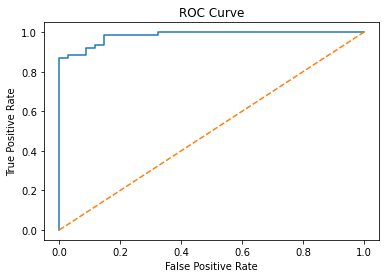

AUC ROC Score: 0.9821600771456123


In [55]:
#Model Evaluation
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, roc_auc_score

#model.fit(X_train_resampled[selected_features], Y_train_resampled)
# Predict on the test data
#Y_pred = selector.predict(X_test_scaled)
Y_pred = best_rf_clf.predict(X_test_scaled)

# Calculate metrics
accuracy = accuracy_score(Y_pred, Y_test)
precision = precision_score(Y_pred, Y_test)
recall = recall_score(Y_pred, Y_test)
f1 = f1_score(Y_pred, Y_test)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")

# Confusion Matrix
cm = confusion_matrix(Y_pred, Y_test)
print(f"Confusion Matrix:\n{cm}")

# ROC Curve
#Y_prob = model.predict_proba(X_test_selected)[:,1]
#Y_prob = selector.predict_proba(X_test_scaled)[:,1]
Y_prob = best_rf_clf.predict_proba(X_test_scaled)[:,1]

fpr, tpr, thresholds = roc_curve(Y_test, Y_prob)
plt.plot(fpr, tpr)
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

# ROC AUC Score
roc_auc = roc_auc_score(Y_test, Y_prob)
print(f"AUC ROC Score: {roc_auc}")


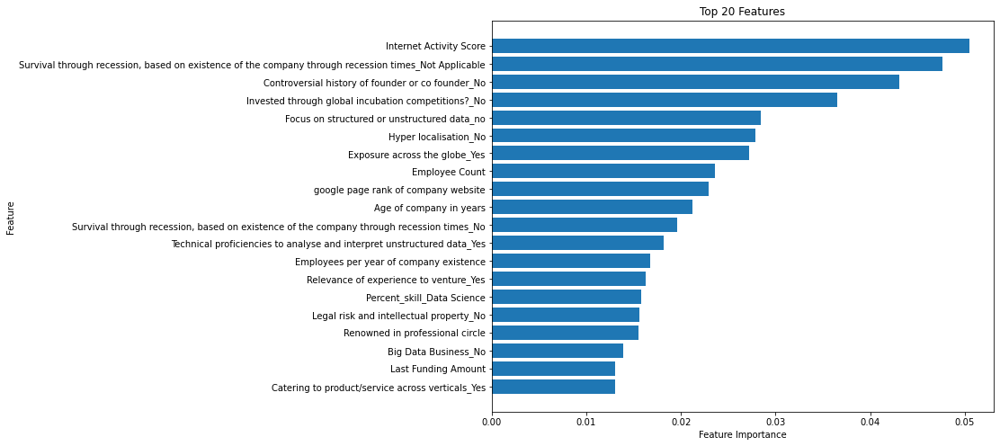

In [56]:
import matplotlib.pyplot as plt

# Get the feature importances from the random forest model
feature_importances = best_rf_clf.feature_importances_

# Get the feature names from your training DataFrame
feature_names = X_train_scaled.columns

# Create a dictionary of feature names and their importance scores
features_importances = dict(zip(feature_names, feature_importances))


# Sort the features by importance
sorted_features = sorted(features_importances.items(), key=lambda x: x[1], reverse=True)

# Select the top 20 features
top_20_features = sorted_features[:20]

# Separate the feature names and importance values
sorted_feature_names, sorted_importances = zip(*sorted_features)

# Create a bar chart of the top 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[:20], sorted_importances[:20])
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Top 20 Features')
plt.gca().invert_yaxis() # This will display the bar with the highest importance at the top
plt.show()



In [57]:
# Print the top 20 features and their coefficients
print("Top 20 features:")
for feature, coef in sorted_features[:20]:
    print(f"{feature}: {coef}")

print("\n")

# Print the bottom 20 features and their coefficients
print("Bottom 20 features:")
for feature, coef in sorted_features[-20:]:
    print(f"{feature}: {coef}")


Top 20 features:
Internet Activity Score: 0.050514678976298626
Survival through recession, based on existence of the company through recession times_Not Applicable: 0.047597635236141564
Controversial history of founder or co founder_No: 0.04308651952843475
Invested through global incubation competitions?_No: 0.03656097160096427
Focus on structured or unstructured data_no: 0.028460550391861402
Hyper localisation_No: 0.027873344274572064
Exposure across the globe_Yes: 0.027208075750418028
Employee Count: 0.023607744753660207
google page rank of company website: 0.022900052601898615
Age of company in years: 0.021240655672611065
Survival through recession, based on existence of the company through recession times_No: 0.01956013717947748
Technical proficiencies to analyse and interpret unstructured data_Yes: 0.018134328413779797
Employees per year of company existence: 0.016781338683175866
Relevance of experience to venture_Yes: 0.01631000526289255
Percent_skill_Data Science: 0.015773238883

In [58]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier

from sklearn.model_selection import LeaveOneOut, cross_val_score

loo = LeaveOneOut()

# Define the parameter grid
param_grid = {
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4],
    'n_estimators': [100,200,500]
    
}

# Initialize the RandomForestClassifier
rf_clf = RandomForestClassifier(random_state=42)

# Initialize the GridSearchCV object
grid_search = GridSearchCV(rf_clf, param_grid, cv=10, scoring='accuracy', verbose=1, n_jobs=-1)

# Selecting only the top 20 features for training data
X_train_selected = X_train_scaled[[feature[0] for feature in top_20_features]]

# Similarly for test data (if you have it)
X_test_selected = X_test_scaled[[feature[0] for feature in top_20_features]]

# Fit the GridSearchCV object to the data
grid_search.fit(X_train_selected, Y_train)

# Print the best parameters and their corresponding accuracy score
print("Best parameters found: ", grid_search.best_params_)
print("Best validation score (Accuracy): ", grid_search.best_score_)

# Retrieve the best estimator directly
best_rf_clf = grid_search.best_estimator_



Fitting 10 folds for each of 216 candidates, totalling 2160 fits
Best parameters found:  {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}
Best validation score (Accuracy):  0.9125177809388336


Accuracy: 0.9368421052631579
Precision: 0.9365079365079365
Recall: 0.9672131147540983
F1 Score: 0.9516129032258064
Confusion Matrix:
[[30  4]
 [ 2 59]]


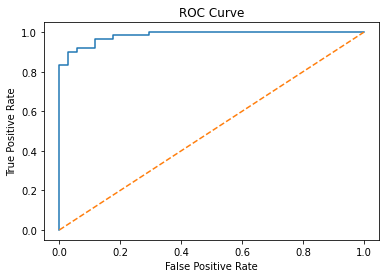

AUC ROC Score: 0.9836065573770493


In [59]:
# Model Evaluation
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, roc_auc_score
import matplotlib.pyplot as plt

# Predict on the test data using the model trained on the top 20 features
Y_pred = best_rf_clf.predict(X_test_selected)

# Calculate metrics
accuracy = accuracy_score(Y_test, Y_pred)
precision = precision_score(Y_test, Y_pred)
recall = recall_score(Y_test, Y_pred)
f1 = f1_score(Y_test, Y_pred)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")

# Confusion Matrix
cm = confusion_matrix(Y_test, Y_pred)
print(f"Confusion Matrix:\n{cm}")

# ROC Curve
Y_prob = best_rf_clf.predict_proba(X_test_selected)[:,1]

fpr, tpr, thresholds = roc_curve(Y_test, Y_prob)
plt.plot(fpr, tpr)
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

# ROC AUC Score
roc_auc = roc_auc_score(Y_test, Y_prob)
print(f"AUC ROC Score: {roc_auc}")


In [60]:
# Identify binary columns (having exactly 2 unique values) after thresholding and imputation
binary_cols = [col for col in X_train_selected.columns if X_train_selected[col].nunique() == 2]

# Identify columns to scale 
columns_to_scale = [col for col in X_train_selected.columns if col not in binary_cols]

In [66]:
print(columns_to_scale)

['Internet Activity Score', 'Employee Count', 'google page rank of company website', 'Age of company in years', 'Employees per year of company existence', 'Percent_skill_Data Science', 'Renowned in professional circle', 'Last Funding Amount']


In [61]:
from sklearn.preprocessing import StandardScaler

# Scale only the non-binary columns
scaler = StandardScaler()
X_train_selected[columns_to_scale] = scaler.fit_transform(X_train_selected[columns_to_scale])
X_test_selected[columns_to_scale] = scaler.transform(X_test_selected[columns_to_scale])


C:\Users\ramsa\AppData\Local\Temp\ipykernel_1684\523309613.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train_selected[columns_to_scale] = scaler.fit_transform(X_train_selected[columns_to_scale])
C:\Users\ramsa\AppData\Local\Temp\ipykernel_1684\523309613.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test_selected[columns_to_scale] = scaler.transform(X_test_selected[columns_to_scale])


In [62]:
from joblib import dump

# Save XGBoost model after fitting and evaluation
dump(grid_search, 'rf_model_8020_sept22.joblib')

['rf_model_8020_sept22.joblib']

In [63]:
# To save the scaler object 
from joblib import dump
dump(scaler, 'scaler_rf8020_sept22.joblib')
# Save training data with feature names
X_train_selected.to_csv('training_rf8020_sept22.csv', index=False)
dump(top_20_features, 'selector_rf8020sept22.joblib')

['selector_rf8020sept22.joblib']

In [65]:
feature_column = 'Age of company in years'
print(f"Range: {df[feature_column].min()} to {df[feature_column].max()}")

Range: 1.0 to 17.0


In [67]:
from lime.lime_tabular import LimeTabularExplainer

# Step 3: Interpretation with LIME
best_model = grid_search.best_estimator_

# Convert the DataFrame to a NumPy array
X_train_np = X_train_scaled.to_numpy()

explainer = LimeTabularExplainer(X_train_np, 
                                 feature_names=X_train_scaled.columns.tolist(), 
                                 class_names=['failure', 'success'], 
                                 verbose=True, 
                                 mode='classification')

# Select a single instance to interpret (for example, the first instance in the test set)
i = 10
exp = explainer.explain_instance(X_test_scaled.values[i], best_model.predict_proba, num_features=5)
exp.show_in_notebook()


C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Intercept 0.4570419522219704
Prediction_local [0.7782297]
Right: 0.605


C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\llvmlite\llvmpy\__init__.py:3: UserWarning: The module `llvmlite.llvmpy` is deprecated and will be removed in the future.
  warnings.warn(
C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\llvmlite\llvmpy\core.py:8: UserWarning: The module `llvmlite.llvmpy.core` is deprecated and will be removed in the future. Equivalent functionality is provided by `llvmlite.ir`.
  warnings.warn(
C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\llvmlite\llvmpy\passes.py:17: UserWarning: The module `llvmlite.llvmpy.passes` is deprecated and will be removed in the future. If you are using this code, it should be inlined into your own project.
  warnings.warn(


Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


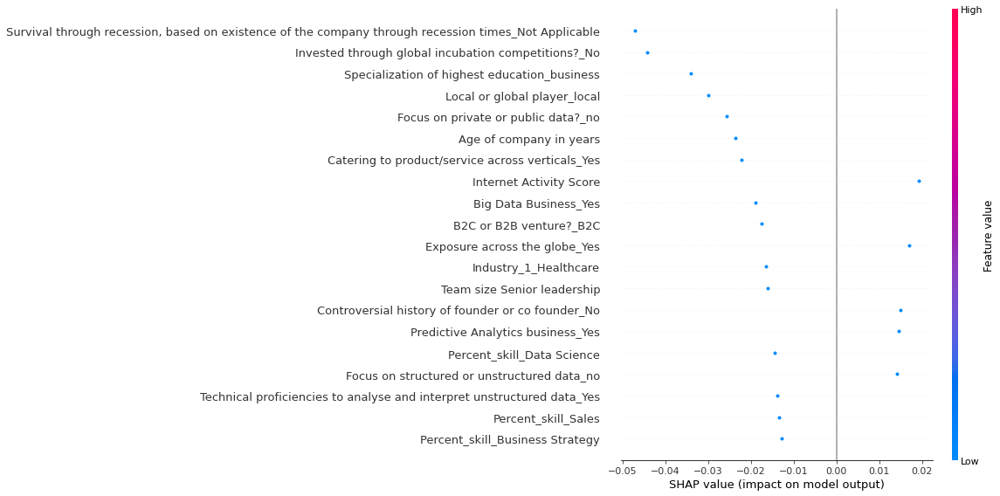

In [59]:
import shap

# Step 3: Interpretation with SHAP
best_model = grid_search.best_estimator_

# Create a Tree explainer for the model
explainer = shap.TreeExplainer(best_model)

# Calculate SHAP values for a sample of the training data (for performance reasons)
shap_values = explainer.shap_values(X_train_scaled.sample(1, random_state=42))

# Visualize the SHAP values for the first instance in the test set
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][0], X_test_scaled.iloc[0])

# Plot summary of SHAP values for all features across all instances
shap.summary_plot(shap_values[1], X_train_scaled.sample(1, random_state=42))


Selected index: 10


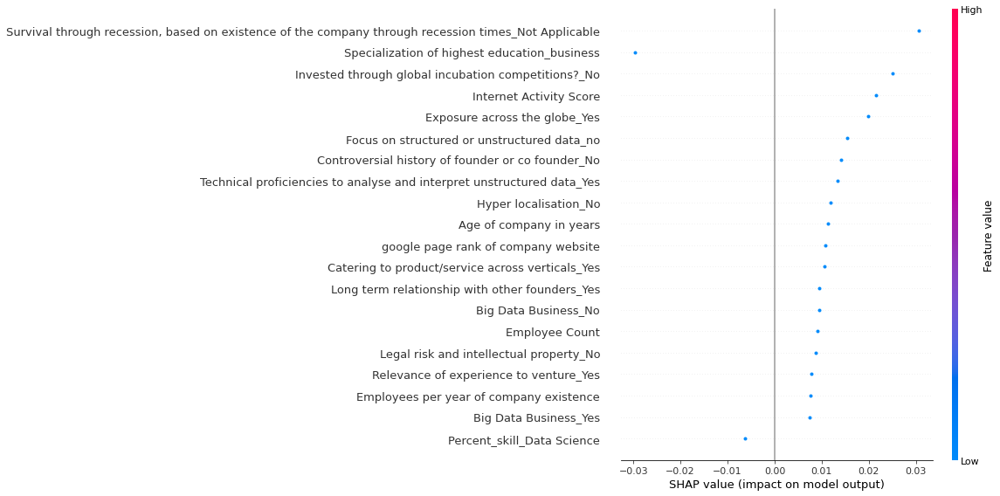

In [65]:
import shap

# Step 3: Interpretation with SHAP
best_model = grid_search.best_estimator_

# Create a Tree explainer for the model
explainer = shap.TreeExplainer(best_model)

# Select a specific index from the training data
selected_index = 10  # Replace 0 with the desired index
sample = X_train_scaled.iloc[[selected_index]]

# Print the selected index
print("Selected index:", selected_index)

# Calculate SHAP values for the selected instance
shap_values = explainer.shap_values(sample)

# Visualize the SHAP values for the selected instance
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][0], sample)

# Plot summary of SHAP values for the selected instance
shap.summary_plot(shap_values[1], sample)


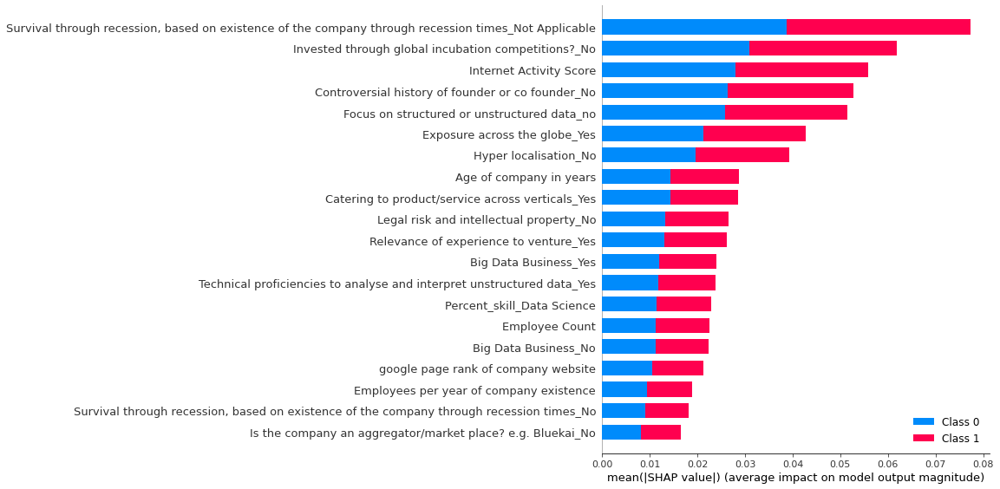

In [61]:
import shap


# Step 3: Interpretation with SHAP
best_model = grid_search.best_estimator_

# Create a Tree explainer for the model
explainer = shap.TreeExplainer(best_model)


# Compute SHAP values for the entire training set
shap_values = explainer.shap_values(X_train_scaled)

# Visualize the SHAP values for the entire training set
shap.summary_plot(shap_values, X_train_scaled, plot_type="bar")


In [62]:
import shap


# Step 3: Interpretation with SHAP
best_model = grid_search.best_estimator_

# Create a Tree explainer for the model
explainer = shap.TreeExplainer(best_model)

# Compute SHAP values for the instance at index 0
shap_values_instance = explainer.shap_values(X_train_scaled.iloc[5,:])

# Visualize the SHAP values for the instance at index 0
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values_instance[1], X_train_scaled.iloc[5,:])


from lime.lime_tabular import LimeTabularExplainer

# Step 3: Interpretation with LIME
best_model = grid_search.best_estimator_
explainer = LimeTabularExplainer(X_train_resampled[selected.values, 
                                 feature_names=selected_features.tolist(), 
                                 class_names=['failure', 'success'], 
                                 verbose=True, 
                                 mode='classification')

# Select a single instance to interpret (for example, the first instance in the test set)
i = 0
exp = explainer.explain_instance(X_test_scaled.values[i], best_model.predict_proba, num_features=10)
exp.show_in_notebook()


In [62]:
from lime.lime_tabular import LimeTabularExplainer

# Step 3: Interpretation with LIME
best_model = grid_search.best_estimator_
explainer = LimeTabularExplainer(X_train_resampled[selected_features].values, 
                                 feature_names=selected_features.tolist(), 
                                 class_names=['failure', 'success'], 
                                 verbose=True, 
                                 mode='classification')

# Select the first 5 instances to interpret
for i in range(5):
    print(f"Explanation for Instance {i+1}:")
    exp = explainer.explain_instance(X_test_selected.values[i], best_model.predict_proba, num_features=5)
    exp.show_in_notebook(show_predicted_value=True)


Explanation for Instance 1:
Intercept 0.49912655012626694
Prediction_local [0.10777763]
Right: 0.000814471875891645


C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explanation for Instance 2:
Intercept -0.3326530810619436
Prediction_local [1.04702579]
Right: 0.9999667268988418


C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explanation for Instance 3:
Intercept 0.49067358692442803
Prediction_local [0.72539549]
Right: 0.9804398817369057


C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explanation for Instance 4:
Intercept 0.40180532319286
Prediction_local [0.80563495]
Right: 0.9998948238008959


C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Explanation for Instance 5:
Intercept 1.2529205950058748
Prediction_local [-0.10656302]
Right: 0.00023663484476135475


C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


In [64]:
import shap

# Step 3: Interpretation with SHAP
explainer = shap.Explainer(best_model, X_train_resampled[selected_features])
shap_values = explainer.shap_values(X_test_selected)

# Plot the SHAP values for a single prediction (for example, the first instance in the test set)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test_selected.iloc[0,:])


Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


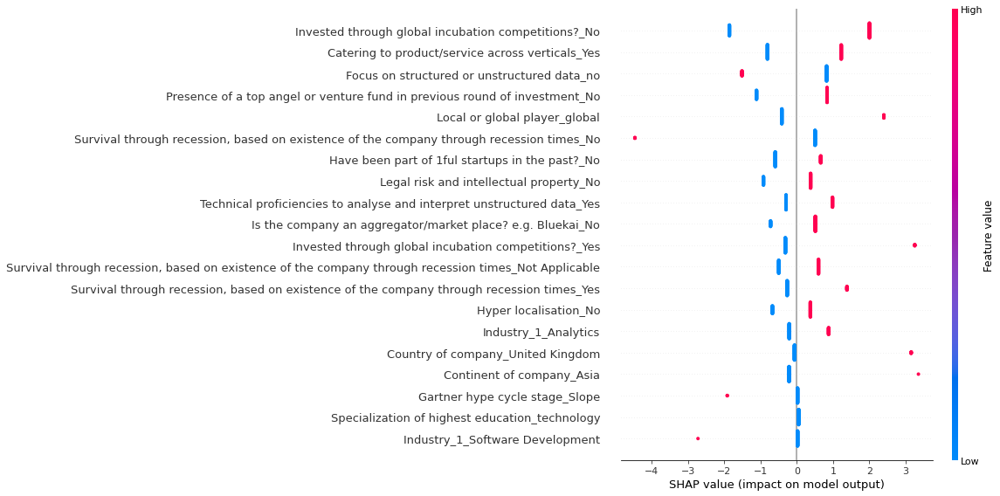

In [68]:
# Create a new list of feature names with only the first 3 and last 3 words
shortened_feature_names = [' '.join(name.split()[:3]) + ' ... ' + ' '.join(name.split()[-3:]) for name in selected_features.tolist()]

# Step 3: Interpretation with SHAP using shortened feature names
explainer = shap.Explainer(best_model, X_train_resampled[selected_features], feature_names=shortened_feature_names)
shap_values = explainer.shap_values(X_test_selected)

# Plot the SHAP values for a single prediction (for example, the first instance in the test set)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test_selected.iloc[0,:], feature_names=shortened_feature_names)

plt.figure(figsize=(10, 8))
shap.summary_plot(shap_values, X_test_selected)

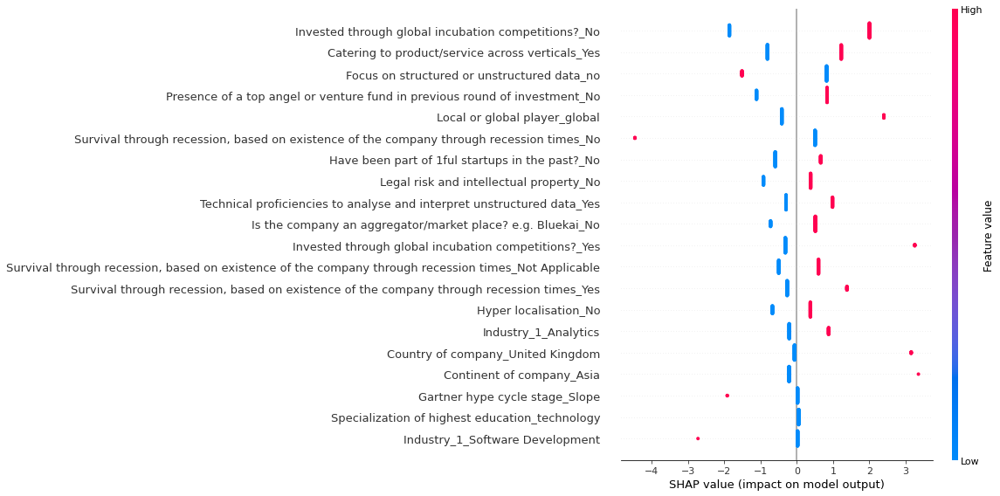

In [82]:
# Create a new list of feature names with only the first 3 and last 3 words
shortened_feature_names = [' '.join(name.split()[:3]) + ' ... ' + ' '.join(name.split()[-3:]) for name in selected_features.tolist()]

# Step 3: Interpretation with SHAP using shortened feature names
explainer = shap.Explainer(best_model, X_train_resampled[selected_features], feature_names=shortened_feature_names)
shap_values = explainer.shap_values(X_test_selected)

# Plot the SHAP values for a single prediction (for example, the first instance in the test set)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[13,:], X_test_selected.iloc[13,:], feature_names=shortened_feature_names)

plt.figure(figsize=(10, 8))
shap.summary_plot(shap_values, X_test_selected)

In [85]:
# Create a new list of feature names with only the first 3 and last 3 words
shortened_feature_names = [' '.join(name.split()[:3]) + ' ... ' + ' '.join(name.split()[-3:]) for name in selected_features.tolist()]

# Step 3: Interpretation with SHAP using shortened feature names
explainer = shap.Explainer(best_model, X_train_resampled[selected_features], feature_names=shortened_feature_names)
shap_values = explainer.shap_values(X_test_selected)

# Plot the SHAP values for a single prediction (for example, the 13th instance in the test set)
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][13,:], X_test_selected.iloc[13,:], feature_names=shortened_feature_names)


IndexError: invalid index to scalar variable.

In [55]:
# Calculate the correlation matrix
correlation_matrix = X_train_imputed.corr()

# Display the correlation between 'Invested through global incubation competitions' features and others
incubation_correlations = correlation_matrix.loc[:, ['Invested through global incubation competitions?_Yes', 'Invested through global incubation competitions?_No']]
print(incubation_correlations)


KeyError: "None of [Index(['Invested through global incubation competitions?_Yes', 'Invested through global incubation competitions?_No'], dtype='object')] are in the [columns]"



# Assuming correlation_matrix is the variable holding your correlation matrix
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt=".2f")

plt.title('Correlation Matrix')
plt.show()


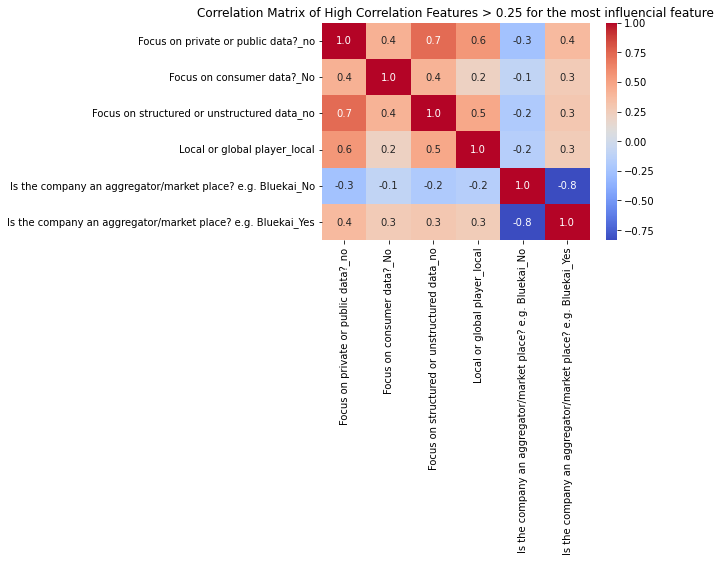

In [56]:
# Get correlations with the target variable
target_correlations = correlation_matrix['Is the company an aggregator/market place? e.g. Bluekai_Yes']

# Get features that have a correlation above a certain threshold
high_corr_features = target_correlations[abs(target_correlations) >.25].index

# Create a heatmap using only high correlation features
sns.heatmap(correlation_matrix.loc[high_corr_features, high_corr_features], cmap='coolwarm', annot=True, fmt=".1f")

plt.title('Correlation Matrix of High Correlation Features > 0.25 for the most influencial feature')
plt.show()


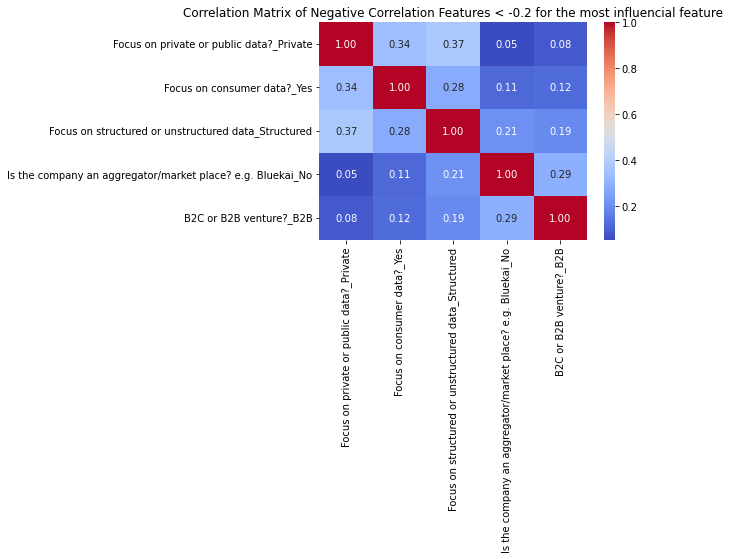

In [57]:
# Get correlations with the target variable
target_correlations = correlation_matrix['Is the company an aggregator/market place? e.g. Bluekai_Yes']

# Get features that have a correlation below a certain negative threshold
negative_corr_features = target_correlations[target_correlations < -0.2].index

# Create a heatmap using only negative correlation features
sns.heatmap(correlation_matrix.loc[negative_corr_features, negative_corr_features], cmap='coolwarm', annot=True, fmt=".2f")

plt.title('Correlation Matrix of Negative Correlation Features < -0.2 for the most influencial feature')
plt.show()


In [62]:
# Extract correlations of all features with the specific feature
target_correlations = correlation_matrix['Invested through global incubation competitions?_No']

# Drop the correlation of the feature with itself
target_correlations = target_correlations.drop('Invested through global incubation competitions?_No')

# Display the correlations sorted by their absolute values in descending order
print(target_correlations.abs().sort_values(ascending=False))


Controversial history of founder or co founder_No           0.489088
Invested through global incubation competitions?_Yes        0.448814
Hyper localisation_No                                       0.413848
Relevance of experience to venture_Yes                      0.408583
Exposure across the globe_Yes                               0.407386
                                                              ...   
Specialization of highest education_psychology                   NaN
Specialization of highest education_sb                           NaN
Specialization of highest education_science                      NaN
Specialization of highest education_software engg                NaN
Specialization of highest education_technology mangement         NaN
Name: Invested through global incubation competitions?_No, Length: 356, dtype: float64


In [63]:
# Extract correlations of all features with the specific feature
target_correlations = correlation_matrix['Invested through global incubation competitions?_No']

# Drop the correlation of the feature with itself
target_correlations = target_correlations.drop('Invested through global incubation competitions?_No')

# Display the positive correlations sorted in descending order
positive_correlations = target_correlations[target_correlations > 0].sort_values(ascending=False)
print("Positive Correlations:")
print(positive_correlations)

# Display the negative correlations sorted in ascending order
negative_correlations = target_correlations[target_correlations < 0].sort_values()
print("\nNegative Correlations:")
print(negative_correlations)


Positive Correlations:
Controversial history of founder or co founder_No                                       0.489088
Hyper localisation_No                                                                   0.413848
Relevance of experience to venture_Yes                                                  0.408583
Exposure across the globe_Yes                                                           0.407386
Proprietary or patent position (competitive position)_No                                0.366248
                                                                                          ...   
Online or offline venture - physical location based business or online venture?_Both    0.004504
Product or service company?_Service                                                     0.004421
Percent_skill_Business Strategy                                                         0.004040
Focus on private or public data?_Private                                                0.002833
Is the 

In [ ]:
from imblearn.over_sampling import ADASYN
ada = ADASYN(random_state=42) # Apply ADASYN SMOTE for oversampling to the training set only
X_train_resampled, Y_train_resampled = ada.fit_resample(X_train_scaled, Y_train)

from collections import Counter
# Counts samples in the original and resampled datasets
print("Original dataset shape:", Counter(Y_train))
print("Resampled dataset shape:", Counter(Y_train_resampled))


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import SelectFromModel

# Create a logistic regression classifier with L1 regularization
log_reg = LogisticRegression(penalty='l1', solver='liblinear', random_state=42)

# Fit the classifier on the resampled training data
log_reg.fit(X_train_resampled, Y_train_resampled)

# Create a feature selector object based on the coefficients of the logistic regression model
feature_selector = SelectFromModel(log_reg, threshold='mean')

# Transform the resampled training data and test data to only include the selected features
X_train_selected = feature_selector.fit_transform(X_train_resampled, Y_train_resampled)
X_test_selected = feature_selector.transform(X_test_scaled)

# Get the indices of the selected features
selected_indices = feature_selector.get_support(indices=True)

# Get the names of the selected features (assuming X_train is a DataFrame with column names)
selected_features = X_train.columns[selected_indices]

# Print the names of the selected features
print("Selected Features:", selected_features)


In [ ]:
import matplotlib.pyplot as plt

# Get coefficients from the trained logistic regression model
importances = abs(log_reg.coef_[0])

# Get the feature names
feature_names = X_train.columns

# Create a dictionary of feature names and their importance scores (absolute coefficients)
features_importances = dict(zip(feature_names, importances))

# Sort the features by importance
sorted_features = sorted(features_importances.items(), key=lambda x: x[1], reverse=True)

# Separate the feature names and importance scores
sorted_feature_names, sorted_importances = zip(*sorted_features)

# Create a bar chart of the feature importances
plt.figure(figsize=(30, 20))
plt.barh(sorted_feature_names, sorted_importances)
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importances')
plt.gca().invert_yaxis() # This will display the bar with the highest importance at the top
plt.show()


In [ ]:
# Top 20
# Create a bar chart of the top 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[:20], sorted_importances[:20])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Top 20 Feature Importances from Logistic Regression')
plt.gca().invert_yaxis() # This will display the bar with the highest importance at the top
plt.show()


In [ ]:
# Bottom 20
# Create a bar chart of the bottom 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[-20:], sorted_importances[-20:])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Bottom 20 Feature Importances from Logistic Regression')
plt.gca().invert_yaxis() # This will display the bar with the highest importance at the top
plt.show()


In [ ]:
from sklearn.model_selection import train_test_split

# Separation of features and target variable
X = df.drop('Prediction', axis=1)
Y = df['Prediction']

# Splitting of data into training, validation, and test sets while preserving class distribution
X_train_val, X_test, Y_train_val, Y_test = train_test_split(X, Y, test_size=0.1, stratify=Y, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train_val, Y_train_val, test_size=0.2222, stratify=Y_train_val, random_state=42)

# Conversion of sets back to dataframes
train_df = pd.concat([X_train, Y_train], axis=1)
val_df = pd.concat([X_val, Y_val], axis=1)
test_df = pd.concat([X_test, Y_test], axis=1)

In [43]:
# Separation of features and target variable
X_train = train_df.drop('Prediction', axis=1)
Y_train = train_df['Prediction']

# Splitting into training and validation sets with a 70/30 split ratio while preserving target class distribution
X_train_70, X_train_30, Y_train_70, Y_train_30 = train_test_split(X_train, Y_train, test_size=0.3, random_state=42, stratify=Y_train)


In [44]:
X_train.shape

(329, 357)

In [45]:
# Concatenate features and target variable back into dataframes
train_70_df = pd.concat([X_train_70, Y_train_70], axis=1)
train_30_df = pd.concat([X_train_30, Y_train_30], axis=1)

# Making copies for outlier transformation
train_70_df_clean = train_70_df.copy()
train_30_df_clean = train_30_df.copy()

# Transform outliers using the 1st and 99th percentile values
train_70_q01 = train_70_df_clean.quantile(0.01)
train_70_q99 = train_70_df_clean.quantile(0.99)

# Applying outlier transformation
train_70_df_clean = train_70_df_clean.mask(train_70_df_clean < train_70_q01, train_70_q01, axis=1)
train_70_df_clean = train_70_df_clean.mask(train_70_df_clean > train_70_q99, train_70_q99, axis=1)
train_30_df_clean = train_30_df_clean.mask(train_30_df_clean < train_70_q01, train_70_q01, axis=1)
train_30_df_clean = train_30_df_clean.mask(train_30_df_clean > train_70_q99, train_70_q99, axis=1)

# Convert all columns to numeric data type
train_70_df_clean = train_70_df_clean.apply(pd.to_numeric, errors='coerce')
train_30_df_clean = train_30_df_clean.apply(pd.to_numeric, errors='coerce')


In [46]:
from sklearn.feature_selection import VarianceThreshold

# Separate features from the cleaned 70% training set and 30% validation set
X_train_70_clean = train_70_df_clean.drop("Prediction", axis=1)
X_train_30_clean = train_30_df_clean.drop("Prediction", axis=1)

# Apply variance thresholding
variance_threshold = VarianceThreshold(threshold=0.01)
X_train_70_thresholded = variance_threshold.fit_transform(X_train_70_clean)
X_train_30_thresholded = variance_threshold.transform(X_train_30_clean)

# Get the columns that remain after thresholding
columns_after_thresholding = X_train_70_clean.columns[variance_threshold.get_support()]

# Convert to DataFrame to maintain structure
X_train_70_thresholded = pd.DataFrame(X_train_70_thresholded, columns=columns_after_thresholding)
X_train_30_thresholded = pd.DataFrame(X_train_30_thresholded, columns=columns_after_thresholding)


In [47]:

from sklearn.impute import SimpleImputer
#Impute missing values
imputer = SimpleImputer(strategy='mean')
X_train_70_imputed = imputer.fit_transform(X_train_70_thresholded)
X_train_30_imputed = imputer.transform(X_train_30_thresholded)

# Convert to DataFrame to keep column names
X_train_70_imputed = pd.DataFrame(X_train_70_imputed, columns=columns_after_thresholding)
X_train_30_imputed = pd.DataFrame(X_train_30_imputed, columns=columns_after_thresholding)

In [48]:
# Identify binary columns (having exactly 2 unique values) after thresholding and imputation
binary_cols = [col for col in X_train_70_imputed.columns if X_train_70_imputed[col].nunique() == 2]

# Identify columns to scale (all columns excluding binary ones)
columns_to_scale = [col for col in X_train_70_imputed.columns if col not in binary_cols]


In [49]:
from sklearn.preprocessing import StandardScaler
# Scale only the non-binary columns
scaler = StandardScaler()
X_train_70_imputed[columns_to_scale] = scaler.fit_transform(X_train_70_imputed[columns_to_scale])
X_train_30_imputed[columns_to_scale] = scaler.transform(X_train_30_imputed[columns_to_scale])

#if you want to keep all columns (including both binary and non-binary) in the scaled datasets, you should use:
X_train_scaled = X_train_70_imputed.copy()
X_val_scaled = X_train_30_imputed.copy()


In [50]:
X_val_scaled.shape

(99, 177)

Custom Splitting

Split the training set into a mini training and validation in the ratio of 70/30

In [51]:
!pip install -U imbalanced-learn


# Check for missing values
missing_values = np.isnan(X_train_scaled).sum()
print("Missing values:\n", missing_values)

Missing values:
 Age of company in years                                                   0
Internet Activity Score                                                   0
Employee Count                                                            0
Last Funding Amount                                                       0
Number of Investors in Seed                                               0
                                                                         ..
Gartner hype cycle stage_Slope                                            0
Gartner hype cycle stage_Trigger                                          0
Gartner hype cycle stage_Trough                                           0
Technical proficiencies to analyse and interpret unstructured data_No     0
Technical proficiencies to analyse and interpret unstructured data_Yes    0
Length: 177, dtype: int64


In [52]:
from imblearn.over_sampling import ADASYN
ada = ADASYN(random_state=42) # Apply ADASYN SMOTE for oversampling to the training set only.
X_train_resampled, Y_train_resampled = ada.fit_resample(X_train_scaled, Y_train_70)

from collections import Counter
# Counts samples in the original and resampled datasets
print("Original dataset shape:", Counter(Y_train_70))
print("Resampled dataset shape:", Counter(Y_train_resampled))

Original dataset shape: Counter({1: 149, 0: 81})
Resampled dataset shape: Counter({1: 149, 0: 148})


In [53]:
X_val_scaled.shape

(99, 177)

In [54]:
X_train_resampled.shape

(297, 177)

In [55]:
Y_train_70.shape

(230,)

In [56]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel

# Create a Random Forest classifier
rf = RandomForestClassifier(n_estimators=1000, random_state=42)

# Fit the classifier on the resampled training data
rf.fit(X_train_resampled, Y_train_resampled)

# Calculate the feature importances
importances = rf.feature_importances_

# Create a feature selector object based on the feature importances
feature_selector = SelectFromModel(rf, threshold='mean')

# Transform the resampled training data and validation data to only include the selected features
X_train_selected = feature_selector.fit_transform(X_train_resampled, Y_train_resampled)
X_val_selected = feature_selector.transform(X_val_scaled)

# Get the indices of the selected features
selected_indices = feature_selector.get_support(indices=True)

# Get the names of the selected features (assuming X_train is a DataFrame with column names)
selected_features = X_train.columns[selected_indices]

# Print the names of the selected features
print("Selected Features:", selected_features)


Selected Features: Index(['Age of company in years', 'Internet Activity Score', 'Employee Count',
       'Last Funding Amount', 'Number of Investors in Seed',
       'Team size Senior leadership', 'Years of education',
       'Renowned in professional circle',
       'Experience in Fortune 100 organizations',
       'Number of Recognitions for Founders and Co-founders', 'Skills score',
       'google page rank of company website', 'Industry trend in investing',
       'Number of Direct competitors',
       'Employees per year of company existence',
       'Avg time to investment - average across all rounds, measured from previous investment',
       'Percent_skill_Data Science', 'Percent_skill_Law',
       'Percent_skill_Consulting', 'Industry_1_Agriculture',
       'Presence of a top angel or venture fund in previous round of investment_Yes',
       'Worked in top companies_No',
       'Have been part of 1ful startups in the past?_No',
       'Product or service company?_Service',
   

In [57]:
X_val_selected.shape

(99, 43)

In [58]:
X_train_resampled.shape

(297, 177)

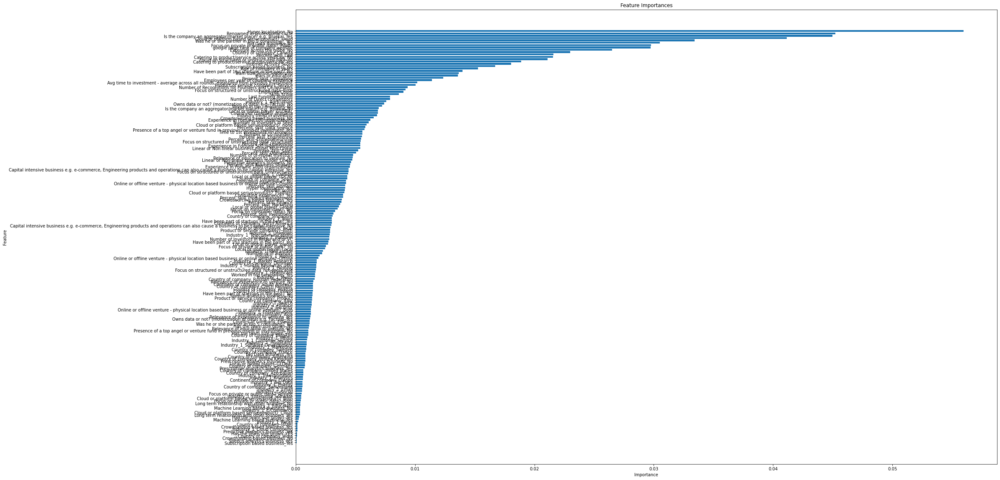

In [59]:

# Get feature importances from the trained random forest model
importances = rf.feature_importances_

# Get the feature names
feature_names = X_train.columns

# Create a dictionary of feature names and their importance scores
features_importances = dict(zip(feature_names, importances))

# Sort the features by importance
sorted_features = sorted(features_importances.items(), key=lambda x: x[1], reverse=True)

# Separate the feature names and importance scores
sorted_feature_names, sorted_importances = zip(*sorted_features)

# Create a bar chart of the feature importances
plt.figure(figsize=(30, 20))
plt.barh(sorted_feature_names, sorted_importances)
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importances')
plt.gca().invert_yaxis() # This will display the bar with the highest importance at the top
plt.show()


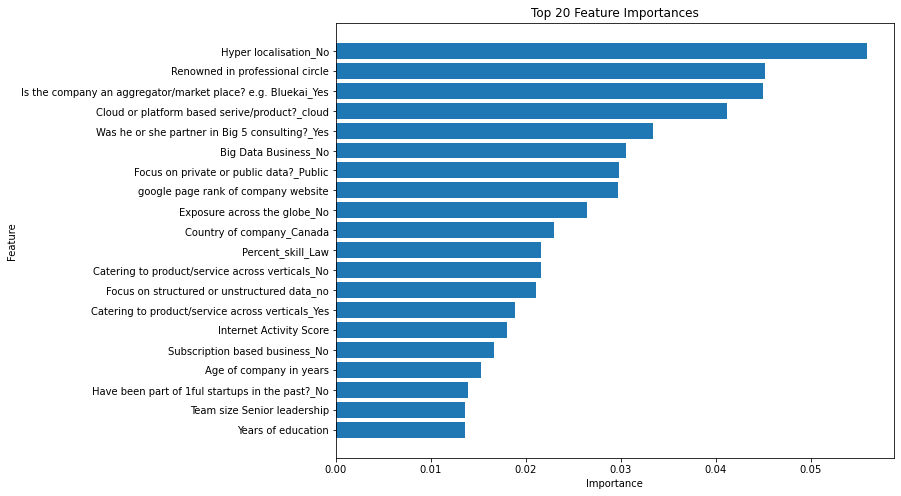

In [60]:
#top 20
# Create a bar chart of the top 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[:20], sorted_importances[:20])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Top 20 Feature Importances')
plt.gca().invert_yaxis() # This will display the bar with the highest importance at the top
plt.show()


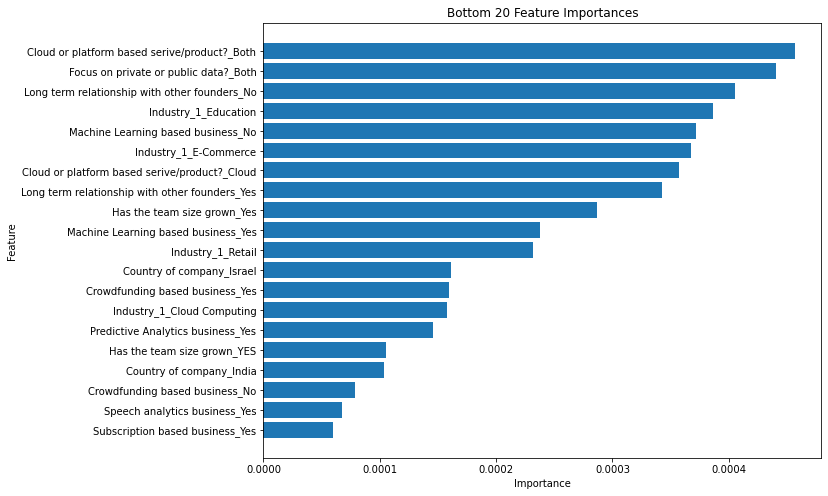

In [61]:
#bottom 20
# Create a bar chart of the bottom 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[-20:], sorted_importances[-20:])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Bottom 20 Feature Importances')
plt.gca().invert_yaxis() # This will display the bar with the lowest importance at the top
plt.show()


In [62]:
import numpy as np
import xgboost as xgb
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelEncoder


# Selection of parameter grid for search
param_grid = {
    'learning_rate': [0.1, 0.2, 0.3],
    'max_depth': [6, 8, 10],
    'n_estimators': [100, 200, 500,1000],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0]
}

# XGBoost classifier
xgbc = xgb.XGBClassifier(random_state=42)

grid_search = GridSearchCV(xgbc, param_grid=param_grid, cv=10, n_jobs=-1)# Performing grid search with cross-validation

# Fitting the model to the training data
grid_search.fit(X_train_selected, Y_train_resampled)

# Print the best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

Y_pred = grid_search.predict(X_val_selected) # Making predictions on the validation data

# Evaluate the performance of the XGBoost classifier
print("XGBoost Classifier:")
print(classification_report(Y_train_30 , Y_pred))
print("Accuracy:", accuracy_score(Y_train_30 , Y_pred))
print("AUC-ROC:", roc_auc_score(Y_train_30 , Y_pred))


Best hyperparameters: {'colsample_bytree': 0.6, 'learning_rate': 0.2, 'max_depth': 6, 'n_estimators': 500, 'subsample': 1.0}
XGBoost Classifier:
              precision    recall  f1-score   support

           0       0.84      0.77      0.81        35
           1       0.88      0.92      0.90        64

    accuracy                           0.87        99
   macro avg       0.86      0.85      0.85        99
weighted avg       0.87      0.87      0.87        99

Accuracy: 0.8686868686868687
AUC-ROC: 0.8466517857142857


In [63]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score

# Parameter grid for Grid Search
param_grid = {
    'n_estimators': [100, 200, 500,1000],
    'max_depth': [6, 8, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# RandomForest Classifier
rfc = RandomForestClassifier(random_state=42)

grid_search = GridSearchCV(rfc, param_grid=param_grid, cv=10, n_jobs=-1)

# Fit model on training data
grid_search.fit(X_train_selected, Y_train_resampled)

# Print best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Predict on validation set
Y_pred = grid_search.predict(X_val_selected)

# Evaluate the RandomForest Classifier
print("RandomForest Classifier:")
print(classification_report(Y_train_30, Y_pred))
print("Accuracy:", accuracy_score(Y_train_30, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_train_30, Y_pred))


Best hyperparameters: {'max_depth': 6, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
RandomForest Classifier:
              precision    recall  f1-score   support

           0       0.91      0.83      0.87        35
           1       0.91      0.95      0.93        64

    accuracy                           0.91        99
   macro avg       0.91      0.89      0.90        99
weighted avg       0.91      0.91      0.91        99

Accuracy: 0.9090909090909091
AUC-ROC: 0.8908482142857143


In [64]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score

# Parameter grid for Grid Search
param_grid = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
}

# MLP Classifier
mlp = MLPClassifier(random_state=42, max_iter=1000)

grid_search = GridSearchCV(mlp, param_grid=param_grid, cv=10, n_jobs=-1)

# Fit model on training data
grid_search.fit(X_train_selected, Y_train_resampled)

# Print best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Predict on validation set
Y_pred = grid_search.predict(X_val_selected)

# Evaluate the MLP Classifier
print("MLP Classifier:")
print(classification_report(Y_train_30, Y_pred))
print("Accuracy:", accuracy_score(Y_train_30, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_train_30, Y_pred))


Best hyperparameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (100,), 'learning_rate': 'constant', 'solver': 'adam'}
MLP Classifier:
              precision    recall  f1-score   support

           0       0.82      0.80      0.81        35
           1       0.89      0.91      0.90        64

    accuracy                           0.87        99
   macro avg       0.86      0.85      0.86        99
weighted avg       0.87      0.87      0.87        99

Accuracy: 0.8686868686868687
AUC-ROC: 0.8531250000000001


In [65]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score

# Parameter grid for Grid Search
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'saga']
}

# Logistic Regression Classifier
logreg = LogisticRegression(random_state=42)

grid_search = GridSearchCV(logreg, param_grid=param_grid, cv=10, n_jobs=-1)

# Fit model on training data
grid_search.fit(X_train_selected, Y_train_resampled)

# Print best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Predict on validation set
Y_pred = grid_search.predict(X_val_selected)

# Evaluate the Logistic Regression Classifier
print("Logistic Regression Classifier:")
print(classification_report(Y_train_30, Y_pred))
print("Accuracy:", accuracy_score(Y_train_30, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_train_30, Y_pred))


Best hyperparameters: {'C': 10, 'penalty': 'l1', 'solver': 'saga'}
Logistic Regression Classifier:
              precision    recall  f1-score   support

           0       0.75      0.77      0.76        35
           1       0.87      0.86      0.87        64

    accuracy                           0.83        99
   macro avg       0.81      0.82      0.81        99
weighted avg       0.83      0.83      0.83        99

Accuracy: 0.8282828282828283
AUC-ROC: 0.8154017857142857


C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(



 # <span style="color:black; font-family: 'Times New Roman', serif; font-size: 30px;">DATA PREPROCESSING AND FEATURE ENGINEERING-STAGE 2 </span>


In [66]:


# Making copies for outlier transformation
train_df_clean = train_df.copy()
val_df_clean = val_df.copy()

# Transform outliers using the 1st and 99th percentile values
train_df_q01 = train_df_clean.quantile(0.01)
train_df_q99 = train_df_clean.quantile(0.99)

# Applying outlier transformation
train_df_clean = train_df_clean.mask(train_df_clean < train_df_q01, train_df_q01, axis=1)
train_df_clean = train_df_clean.mask(train_df_clean > train_df_q99, train_df_q99, axis=1)
val_df_clean = val_df_clean.mask(val_df_clean < train_df_q01, train_df_q01, axis=1)
val_df_clean = val_df_clean.mask(val_df_clean > train_df_q99, train_df_q99, axis=1)

# Convert all columns to numeric data type
train_df_clean = train_df_clean.apply(pd.to_numeric, errors='coerce')
val_df_clean = val_df_clean.apply(pd.to_numeric, errors='coerce')


In [67]:
from sklearn.feature_selection import VarianceThreshold

# Separate features from the cleaned  training set and  validation set
train_df_clean = train_df_clean.drop("Prediction", axis=1)
val_df_clean = val_df_clean.drop("Prediction", axis=1)

# Apply variance thresholding
variance_threshold = VarianceThreshold(threshold=0.01)
train_df_thresholded = variance_threshold.fit_transform(train_df_clean)
val_df_thresholded = variance_threshold.transform(val_df_clean)

# Get the columns that remain after thresholding
columns_after_thresholding = train_df_clean.columns[variance_threshold.get_support()]

# Convert to DataFrame to maintain structure
train_df_thresholded = pd.DataFrame(train_df_thresholded, columns=columns_after_thresholding)
val_df_thresholded = pd.DataFrame(val_df_thresholded, columns=columns_after_thresholding)


In [68]:

from sklearn.impute import SimpleImputer
#Impute missing values
imputer = SimpleImputer(strategy='mean')
train_df_imputed = imputer.fit_transform(train_df_thresholded)
val_df_imputed = imputer.transform(val_df_thresholded)

# Convert to DataFrame to keep column names
train_df_imputed = pd.DataFrame(train_df_imputed, columns=columns_after_thresholding)
val_df_imputed = pd.DataFrame(val_df_imputed, columns=columns_after_thresholding)

In [69]:
# Identify binary columns (having exactly 2 unique values) after thresholding and imputation
binary_cols = [col for col in train_df_imputed.columns if train_df_imputed[col].nunique() == 2]

# Identify columns to scale (all columns excluding binary ones)
columns_to_scale = [col for col in train_df_imputed.columns if col not in binary_cols]


In [70]:
from sklearn.preprocessing import StandardScaler
# Scale only the non-binary columns
scaler = StandardScaler()
train_df_imputed[columns_to_scale] = scaler.fit_transform(train_df_imputed[columns_to_scale])
val_df_imputed[columns_to_scale] = scaler.transform(val_df_imputed[columns_to_scale])

#if you want to keep all columns (including both binary and non-binary) in the scaled datasets, you should use:
X_train_scaled_1 = train_df_imputed.copy()
X_val_scaled_1 = val_df_imputed.copy()

In [71]:
X_train_scaled_1.shape

(329, 184)

In [72]:
from imblearn.over_sampling import ADASYN
ada = ADASYN(random_state=42) # Apply ADASYN SMOTE for oversampling to the training set only.
X_train_resampled_1, Y_train_resampled_1 = ada.fit_resample(X_train_scaled_1, Y_train)

from collections import Counter
# Counts samples in the original and resampled datasets
print("Original dataset shape:", Counter(Y_train))
print("Resampled dataset shape:", Counter(Y_train_resampled_1))

Original dataset shape: Counter({1: 213, 0: 116})
Resampled dataset shape: Counter({0: 215, 1: 213})


In [73]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel

# Create a Random Forest classifier
rf = RandomForestClassifier(n_estimators=1000, random_state=42)

# Fit the classifier on the resampled training data
rf.fit(X_train_resampled_1, Y_train_resampled_1)

# Calculate the feature importances
importances = rf.feature_importances_

# Create a feature selector object based on the feature importances
feature_selector = SelectFromModel(rf, threshold='mean')

# Transform the resampled training data and validation data to only include the selected features
X_train_selected_1 = feature_selector.fit_transform(X_train_resampled_1, Y_train_resampled_1)
X_val_selected_1 = feature_selector.transform(X_val_scaled_1)

# Get the indices of the selected features
selected_indices = feature_selector.get_support(indices=True)

# Get the names of the selected features (assuming X_train is a DataFrame with column names)
selected_features = X_train.columns[selected_indices]

# Print the names of the selected features
print("Selected Features:", selected_features)


Selected Features: Index(['Age of company in years', 'Internet Activity Score', 'Employee Count',
       'Last Funding Amount', 'Team size Senior leadership',
       'Years of education', 'Renowned in professional circle',
       'Experience in Fortune 100 organizations',
       'Experience in Fortune 500 organizations',
       'Number of Recognitions for Founders and Co-founders', 'Skills score',
       'google page rank of company website', 'Industry trend in investing',
       'Number of Direct competitors',
       'Employees per year of company existence',
       'Time to 1st investment (in months)',
       'Avg time to investment - average across all rounds, measured from previous investment',
       'Percent_skill_Operations', 'Percent_skill_Engineering',
       'Percent_skill_Leadership', 'Percent_skill_Product Management',
       'Percent_skill_Domain', 'Percent_skill_Law', 'Percent_skill_Consulting',
       'Percent_skill_Investment', 'Renown score', 'Industry_1_Agriculture',


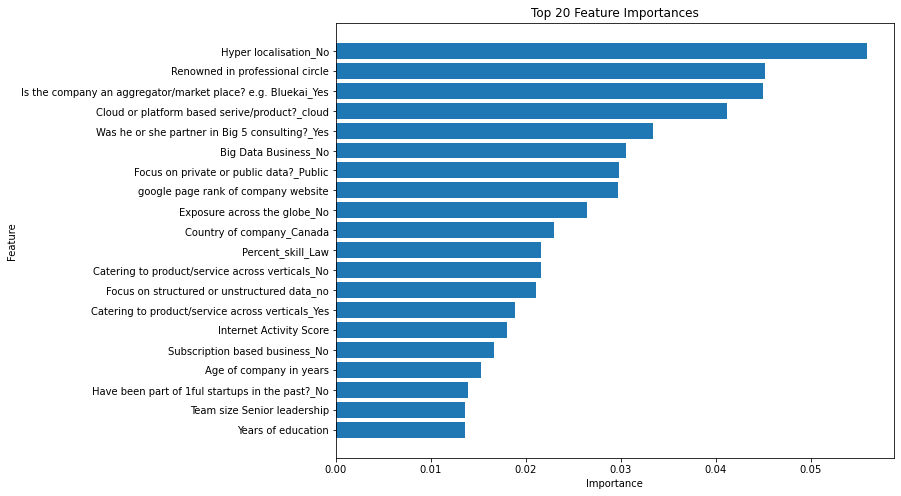

In [74]:
#top 20
# Create a bar chart of the top 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[:20], sorted_importances[:20])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Top 20 Feature Importances')
plt.gca().invert_yaxis() # This will display the bar with the highest importance at the top
plt.show()


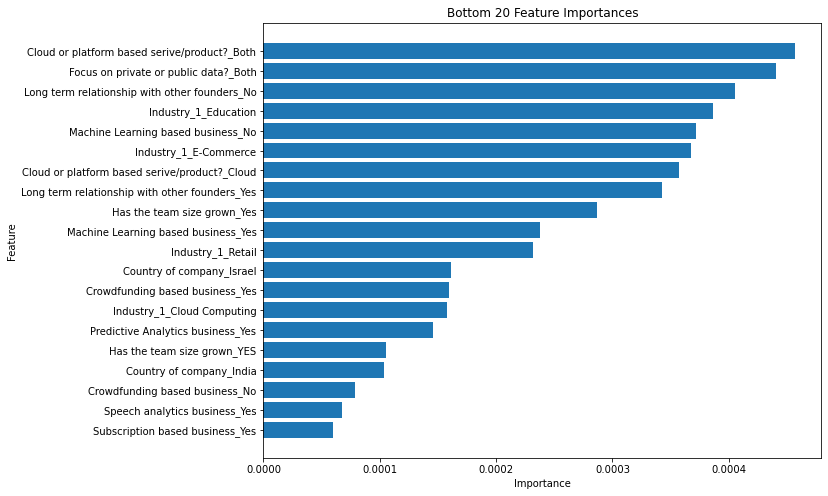

In [75]:
#bottom 20
# Create a bar chart of the bottom 20 feature importances
plt.figure(figsize=(10, 8))
plt.barh(sorted_feature_names[-20:], sorted_importances[-20:])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Bottom 20 Feature Importances')
plt.gca().invert_yaxis() # This will display the bar with the lowest importance at the top
plt.show()


In [76]:
import numpy as np
import xgboost as xgb
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelEncoder


# Selection of parameter grid for search
param_grid = {
    'learning_rate': [0.1, 0.2, 0.3],
    'max_depth': [6, 8, 10],
    'n_estimators': [100, 200, 500,1000],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0]
}

# XGBoost classifier
xgbc = xgb.XGBClassifier(random_state=42)

grid_search = GridSearchCV(xgbc, param_grid=param_grid, cv=10, n_jobs=-1)# Performing grid search with cross-validation

# Fitting the model to the training data
grid_search.fit(X_train_selected_1, Y_train_resampled_1)

# Print the best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

Y_pred = grid_search.predict(X_val_selected_1) # Making predictions on the validation data

# Evaluate the performance of the XGBoost classifier
print("XGBoost Classifier:")
print(classification_report(Y_val, Y_pred))
print("Accuracy:", accuracy_score(Y_val, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_val, Y_pred))


Best hyperparameters: {'colsample_bytree': 0.6, 'learning_rate': 0.2, 'max_depth': 8, 'n_estimators': 200, 'subsample': 1.0}
XGBoost Classifier:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88        34
           1       0.93      0.93      0.93        61

    accuracy                           0.92        95
   macro avg       0.91      0.91      0.91        95
weighted avg       0.92      0.92      0.92        95

Accuracy: 0.9157894736842105
AUC-ROC: 0.9083895853423336


In [77]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score

# Parameter grid for Grid Search
param_grid = {
    'n_estimators': [100, 200, 500,1000],
    'max_depth': [6, 8, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# RandomForest Classifier
rfc = RandomForestClassifier(random_state=42)

grid_search = GridSearchCV(rfc, param_grid=param_grid, cv=10, n_jobs=-1)

# Fit model on training data
grid_search.fit(X_train_selected_1, Y_train_resampled_1)

# Print best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Predict on validation set
Y_pred = grid_search.predict(X_val_selected_1)

# Evaluate the RandomForest Classifier
print("RandomForest Classifier:")
print(classification_report(Y_val, Y_pred))
print("Accuracy:", accuracy_score(Y_val, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_val, Y_pred))


Best hyperparameters: {'max_depth': 6, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
RandomForest Classifier:
              precision    recall  f1-score   support

           0       0.89      0.91      0.90        34
           1       0.95      0.93      0.94        61

    accuracy                           0.93        95
   macro avg       0.92      0.92      0.92        95
weighted avg       0.93      0.93      0.93        95

Accuracy: 0.9263157894736842
AUC-ROC: 0.9230954676952748


In [78]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score

# Parameter grid for Grid Search
param_grid = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
}

# MLP Classifier
mlp = MLPClassifier(random_state=42, max_iter=1000)

grid_search = GridSearchCV(mlp, param_grid=param_grid, cv=10, n_jobs=-1)

# Fit model on training data
grid_search.fit(X_train_selected_1, Y_train_resampled_1)

# Print best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Predict on validation set
Y_pred = grid_search.predict(X_val_selected_1)

# Evaluate the MLP Classifier
print("MLP Classifier:")
print(classification_report(Y_val, Y_pred))
print("Accuracy:", accuracy_score(Y_val, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_val, Y_pred))


Best hyperparameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 100, 50), 'learning_rate': 'constant', 'solver': 'adam'}
MLP Classifier:
              precision    recall  f1-score   support

           0       0.83      0.88      0.86        34
           1       0.93      0.90      0.92        61

    accuracy                           0.89        95
   macro avg       0.88      0.89      0.89        95
weighted avg       0.90      0.89      0.90        95

Accuracy: 0.8947368421052632
AUC-ROC: 0.8919961427193828


In [79]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score

# Parameter grid for Grid Search
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'saga']
}

# Logistic Regression Classifier
logreg = LogisticRegression(random_state=42)

grid_search = GridSearchCV(logreg, param_grid=param_grid, cv=10, n_jobs=-1)

# Fit model on training data
grid_search.fit(X_train_selected_1, Y_train_resampled_1)

# Print best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Predict on validation set
Y_pred = grid_search.predict(X_val_selected_1)

# Evaluate the Logistic Regression Classifier
print("Logistic Regression Classifier:")
print(classification_report(Y_val, Y_pred))
print("Accuracy:", accuracy_score(Y_val, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_val, Y_pred))


Best hyperparameters: {'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}
Logistic Regression Classifier:
              precision    recall  f1-score   support

           0       0.82      0.91      0.86        34
           1       0.95      0.89      0.92        61

    accuracy                           0.89        95
   macro avg       0.88      0.90      0.89        95
weighted avg       0.90      0.89      0.90        95

Accuracy: 0.8947368421052632
AUC-ROC: 0.8985053037608486



 # <span style="color:black; font-family: 'Times New Roman', serif; font-size: 30px;">MODELLING  STAGE-2 RE-TRAINING AND VALIDATION</span>

final 10 percent

In [80]:


# Making copies for outlier transformation
train_df_clean = train_df.copy()
test_df_clean = test_df.copy()

# Transform outliers using the 1st and 99th percentile values
train_df_q01 = train_df_clean.quantile(0.01)
train_df_q99 = train_df_clean.quantile(0.99)

# Applying outlier transformation
train_df_clean = train_df_clean.mask(train_df_clean < train_df_q01, train_df_q01, axis=1)
train_df_clean = train_df_clean.mask(train_df_clean > train_df_q99, train_df_q99, axis=1)
test_df_clean = test_df_clean.mask(test_df_clean < train_df_q01, train_df_q01, axis=1)
test_df_clean = test_df_clean.mask(test_df_clean > train_df_q99, train_df_q99, axis=1)

# Convert all columns to numeric data type
train_df_clean = train_df_clean.apply(pd.to_numeric, errors='coerce')
test_df_clean = test_df_clean.apply(pd.to_numeric, errors='coerce')


In [81]:
from sklearn.feature_selection import VarianceThreshold

# Separate features from the cleaned  training set and  validation set
train_df_clean = train_df_clean.drop("Prediction", axis=1)
test_df_clean = test_df_clean.drop("Prediction", axis=1)

# Apply variance thresholding
variance_threshold = VarianceThreshold(threshold=0.01)
train_df_thresholded = variance_threshold.fit_transform(train_df_clean)
test_df_thresholded = variance_threshold.transform(test_df_clean)

# Get the columns that remain after thresholding
columns_after_thresholding = train_df_clean.columns[variance_threshold.get_support()]

# Convert to DataFrame to maintain structure
train_df_thresholded = pd.DataFrame(train_df_thresholded, columns=columns_after_thresholding)
test_df_thresholded = pd.DataFrame(test_df_thresholded, columns=columns_after_thresholding)

from sklearn.impute import SimpleImputer
#Impute missing values
imputer = SimpleImputer(strategy='mean')
train_df_imputed = imputer.fit_transform(train_df_thresholded)
test_df_imputed = imputer.transform(test_df_thresholded)

In [82]:
train_df_imputed = pd.DataFrame(train_df_imputed, columns=columns_after_thresholding)
test_df_imputed = pd.DataFrame(test_df_imputed, columns=columns_after_thresholding)

In [83]:
#get intially selected features
rf = RandomForestClassifier(n_estimators=1000, random_state=42)

# Fit the classifier on the training data (without scaling)
rf.fit(train_df_imputed, Y_train)

# Select features based on feature importance
feature_selector_1 = SelectFromModel(rf, threshold='mean')
train_df_selected = feature_selector_1.fit_transform(train_df_imputed, Y_train)
test_df_selected = feature_selector_1.transform(test_df_imputed)

# Get the selected features
selected_indices_1 = feature_selector_1.get_support(indices=True)
selected_features_1 = train_df_imputed.columns[selected_indices_1]
print("Initially Selected Features:", selected_features_1)

Initially Selected Features: Index(['Age of company in years', 'Internet Activity Score', 'Employee Count',
       'Last Funding Amount', 'Number of Investors in Seed',
       'Number of Co-founders', 'Team size Senior leadership',
       'Years of education', 'Renowned in professional circle',
       'Experience in Fortune 100 organizations',
       'Number of Recognitions for Founders and Co-founders', 'Skills score',
       'google page rank of company website', 'Industry trend in investing',
       'Number of Direct competitors',
       'Employees per year of company existence',
       'Time to 1st investment (in months)',
       'Avg time to investment - average across all rounds, measured from previous investment',
       'Percent_skill_Entrepreneurship', 'Percent_skill_Operations',
       'Percent_skill_Engineering', 'Percent_skill_Marketing',
       'Percent_skill_Data Science', 'Percent_skill_Business Strategy',
       'Percent_skill_Product Management', 'Percent_skill_Sales',

In [84]:
# Convert to DataFrame to maintain structure
train_df_selected = pd.DataFrame(train_df_selected, columns=selected_features_1)
test_df_selected = pd.DataFrame(test_df_selected, columns=selected_features_1)


In [85]:
# Features to remove
features_to_remove = ['Catering to product/service across verticals_Yes', 'Focus on structured or unstructured data_no', 'Big Data Business_Yes',  'Survival through recession, based on existence of the company through recession times_Not Applicable', 'Survival through recession, based on existence of the company through recession times_Yes'] 

# Remove features from DataFrames
train_df_selected = train_df_selected.drop(columns=features_to_remove)
test_df_selected = test_df_selected.drop(columns=features_to_remove)

# Update the list of selected features
final_selected_features = [feature for feature in selected_features_1 if feature not in features_to_remove]
print("Final Selected Features:", final_selected_features)

Final Selected Features: ['Age of company in years', 'Internet Activity Score', 'Employee Count', 'Last Funding Amount', 'Number of Investors in Seed', 'Number of Co-founders', 'Team size Senior leadership', 'Years of education', 'Renowned in professional circle', 'Experience in Fortune 100 organizations', 'Number of Recognitions for Founders and Co-founders', 'Skills score', 'google page rank of company website', 'Industry trend in investing', 'Number of Direct competitors', 'Employees per year of company existence', 'Time to 1st investment (in months)', 'Avg time to investment - average across all rounds, measured from previous investment', 'Percent_skill_Entrepreneurship', 'Percent_skill_Operations', 'Percent_skill_Engineering', 'Percent_skill_Marketing', 'Percent_skill_Data Science', 'Percent_skill_Business Strategy', 'Percent_skill_Product Management', 'Percent_skill_Sales', 'Percent_skill_Domain', 'Percent_skill_Law', 'Percent_skill_Consulting', 'Renown score', 'Industry_1_Analyt

In [86]:
# Identify binary columns (having exactly 2 unique values) after thresholding and imputation
binary_cols = [col for col in train_df_selected.columns if train_df_selected[col].nunique() == 2]

# Identify columns to scale (all columns excluding binary ones)
columns_to_scale = [col for col in train_df_selected.columns if col not in binary_cols]


In [87]:

print("Binary columns:", binary_cols)
print("Columns to scale:", columns_to_scale)

Binary columns: ['Industry_1_Analytics', 'Catering to product/service across verticals_No', 'Focus on private or public data?_no', 'Focus on structured or unstructured data_Structured', 'Local or global player_local', 'Big Data Business_No', 'Hyper localisation_No', 'Relevance of education to venture_Yes', 'Relevance of experience to venture_Yes', 'Exposure across the globe_Yes', 'B2C or B2B venture?_B2B', 'Specialization of highest education_business', 'Controversial history of founder or co founder_No', 'Legal risk and intellectual property_No', 'Invested through global incubation competitions?_No', 'Survival through recession, based on existence of the company through recession times_No', 'Technical proficiencies to analyse and interpret unstructured data_Yes']
Columns to scale: ['Age of company in years', 'Internet Activity Score', 'Employee Count', 'Last Funding Amount', 'Number of Investors in Seed', 'Number of Co-founders', 'Team size Senior leadership', 'Years of education', 'R

In [88]:
feature_column = 'Renown score'
print(f"Range: {df[feature_column].min()} to {df[feature_column].max()}")

Range: 0.0 to 11.0


In [89]:
# Scale only the selected non-binary features
scaler = StandardScaler()
train_df_selected[columns_to_scale] = scaler.fit_transform(train_df_selected[columns_to_scale])
test_df_selected[columns_to_scale] = scaler.transform(test_df_selected[columns_to_scale])

In [90]:
# To save the scaler object 
from joblib import dump
dump(scaler, 'scaler_selected_featuresnews17.joblib')

['scaler_selected_featuresnews17.joblib']

In [91]:
# Save training data with feature names
train_df_selected.to_csv('training_data_14news17.csv', index=False)

In [92]:
dump(final_selected_features, 'selector_1news17.joblib')

['selector_1news17.joblib']

from joblib import load

# Load the saved scaler
scaler = load('scaler_selected_features.joblib')




print("Mean:", scaler.mean_)
print("Scale (Standard Deviation):", scaler.scale_)


In [93]:
# Separate the features and target variables
X_train_selected_1 = train_df_selected
# Assuming Y_test is already defined, or replace with appropriate code to extract the target variable for the test set
X_test_selected_1 = test_df_selected

In [94]:
import xgboost as xgb
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelEncoder


# Selection of parameter grid for search
param_grid = {
    'learning_rate': [0.1, 0.2, 0.3],
    'max_depth': [6, 8, 10],
    'n_estimators': [100, 200, 500,1000],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0]
}

# XGBoost classifier
xgbc = xgb.XGBClassifier(random_state=42)

grid_search = GridSearchCV(xgbc, param_grid=param_grid, cv=10, n_jobs=-1)# Performing grid search with cross-validation

# Fitting the model to the training data
grid_search.fit(X_train_selected_1, Y_train)

# Print the best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

Y_pred = grid_search.predict(X_test_selected_1) # Making predictions on the validation data

# Evaluate the performance of the XGBoost classifier
print("XGBoost Classifier:")
print(classification_report(Y_test, Y_pred))
print("Accuracy:", accuracy_score(Y_test, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_test, Y_pred))


Best hyperparameters: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 8, 'n_estimators': 200, 'subsample': 0.6}
XGBoost Classifier:
              precision    recall  f1-score   support

           0       0.87      0.76      0.81        17
           1       0.88      0.94      0.91        31

    accuracy                           0.88        48
   macro avg       0.87      0.85      0.86        48
weighted avg       0.87      0.88      0.87        48

Accuracy: 0.875
AUC-ROC: 0.8500948766603416


In [95]:
from joblib import dump

# Save XGBoost model after fitting and evaluation
dump(grid_search, 'xg_model_1news17.joblib')

['xg_model_1news17.joblib']

In [96]:
!pip install lime


In [97]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Get the best RandomForest model from the grid search
best_xgb_model = grid_search.best_estimator_

# Instantiate a LIME explainer object
explainer = LimeTabularExplainer(X_train_selected_1.values, 
                                 feature_names=final_selected_features, 
                                 class_names=['Negative', 'Positive'], 
                                 mode='classification')

# Assuming that the first instance in the validation set is of interest
i = 1

# Get the explanation for the prediction on the ith instance in the validation set
exp = explainer.explain_instance(X_test_selected_1.values[i], best_xgb_model.predict_proba, num_features=5)

# Visualize the explanation
exp.show_in_notebook(show_all=False)


In [98]:

# Save the LIME explainer
joblib.dump(explainer, 'lime_explainer_xbgs17.joblib')


NameError: name 'joblib' is not defined

In [99]:
!pip install dill
import dill

dill.dump(explainer, open('lime_explainer_xbgs17.pkl', 'wb'))




C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\llvmlite\llvmpy\__init__.py:3: UserWarning: The module `llvmlite.llvmpy` is deprecated and will be removed in the future.
  warnings.warn(
C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\llvmlite\llvmpy\core.py:8: UserWarning: The module `llvmlite.llvmpy.core` is deprecated and will be removed in the future. Equivalent functionality is provided by `llvmlite.ir`.
  warnings.warn(
C:\Users\ramsa\OneDrive\Newfolder\lib\site-packages\llvmlite\llvmpy\passes.py:17: UserWarning: The module `llvmlite.llvmpy.passes` is deprecated and will be removed in the future. If you are using this code, it should be inlined into your own project.
  warnings.warn(


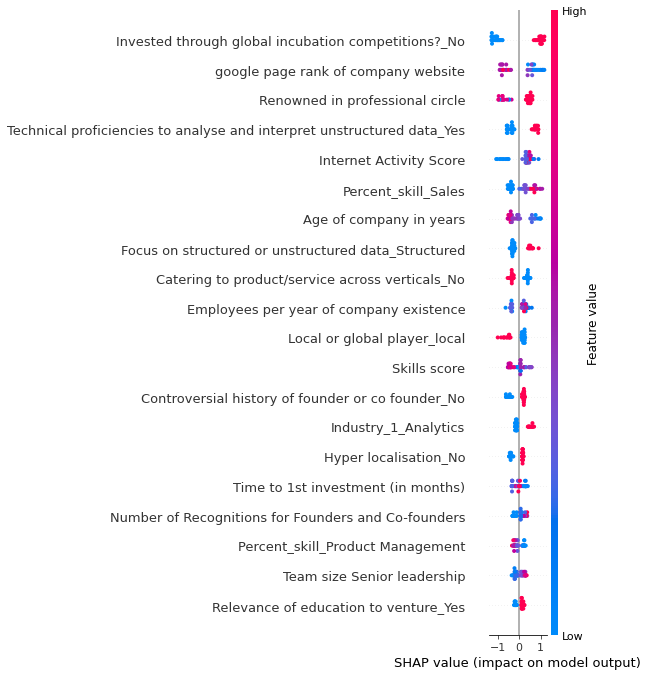

In [100]:
import shap
# Get the best model from your grid search
best_xgb_model = grid_search.best_estimator_

# Initialize a tree explainer with the best XGBoost model and training data
xgb_explainer = shap.Explainer(best_xgb_model, X_train_selected_1)

# Get the SHAP values for all instances in your validation set
xgb_shap_values = xgb_explainer.shap_values(X_test_selected_1, check_additivity=False)

# Plot the SHAP values for all instances in your validation set (for class 0)
shap.summary_plot(xgb_shap_values, X_test_selected_1)


In [102]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score

# Parameter grid for Grid Search
param_grid = {
    'n_estimators': [100, 200, 500,1000],
    'max_depth': [6, 8, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# RandomForest Classifier
rfc = RandomForestClassifier(random_state=42)

grid_search = GridSearchCV(rfc, param_grid=param_grid, cv=10, n_jobs=-1)

# Fit model on training data
grid_search.fit(X_train_selected_1, Y_train)

# Print best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Predict on validation set
Y_pred = grid_search.predict(X_test_selected_1)

# Evaluate the RandomForest Classifier
print("RandomForest Classifier:")
print(classification_report(Y_test, Y_pred))
print("Accuracy:", accuracy_score(Y_test, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_test, Y_pred))


Best hyperparameters: {'max_depth': 8, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
RandomForest Classifier:
              precision    recall  f1-score   support

           0       0.93      0.76      0.84        17
           1       0.88      0.97      0.92        31

    accuracy                           0.90        48
   macro avg       0.91      0.87      0.88        48
weighted avg       0.90      0.90      0.89        48

Accuracy: 0.8958333333333334
AUC-ROC: 0.8662239089184061


In [103]:
from joblib import dump

# Save rfmodel model after fitting and evaluation
dump(grid_search, 'rf_model_1news17.joblib')

['rf_model_1news17.joblib']

In [104]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Get the best RandomForest model from the grid search
best_rf_model = grid_search.best_estimator_

# Instantiate a LIME explainer object
explainer = LimeTabularExplainer(X_train_selected_1.values, 
                                 feature_names=final_selected_features, 
                                 class_names=['Negative', 'Positive'], 
                                 mode='classification')

# Assuming that the first instance in the validation set is of interest
i = 1

# Get the explanation for the prediction on the ith instance in the validation set
exp = explainer.explain_instance(X_test_selected_1.values[i], best_rf_model.predict_proba, num_features=5)

# Visualize the explanation
exp.show_in_notebook(show_all=False)


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


# Save the LIME explainer
joblib.dump(explainer, 'lime_explainer_rfs17.joblib')

In [105]:

dill.dump(explainer, open('lime_explainer_rfs17.pkl', 'wb'))




Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


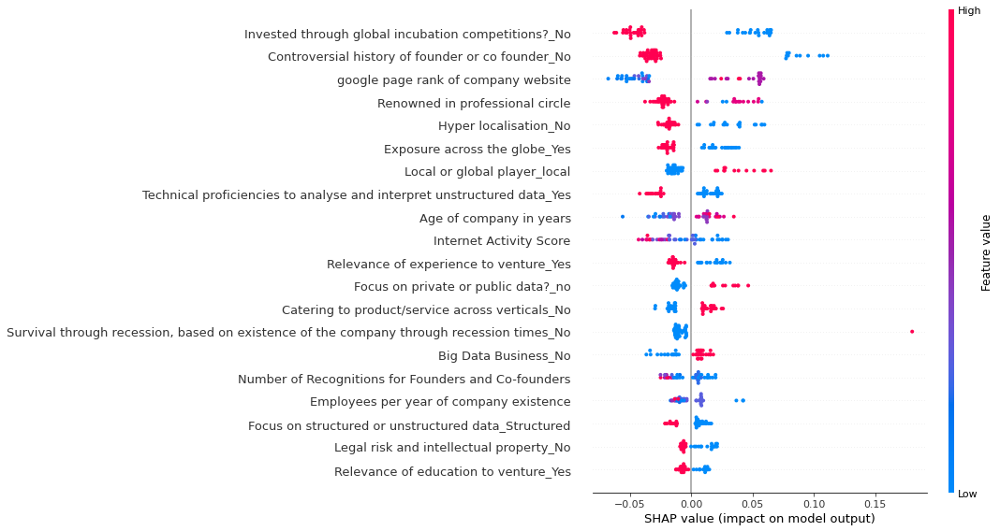

In [106]:
import shap

# Get the best model from your grid search
best_rf_model = grid_search.best_estimator_

# Initialize a tree explainer with the best random forest model and training data
rf_explainer = shap.Explainer(best_rf_model, X_train_selected_1)

# Get the SHAP values for all instances in your validation set
rf_shap_values = rf_explainer.shap_values(X_test_selected_1, check_additivity=False)

# Plot the SHAP values for all instances in your validation set (for class 0)
shap.summary_plot(rf_shap_values[0], X_test_selected_1)


from joblib import dump

# Save XGBoost model after fitting and evaluation
dump(grid_search, 'rf_model_1.joblib')

In [107]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score

# Parameter grid for Grid Search
param_grid = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
}

# MLP Classifier
mlp = MLPClassifier(random_state=42, max_iter=1000)

grid_search = GridSearchCV(mlp, param_grid=param_grid, cv=10, n_jobs=-1)

# Fit model on training data
grid_search.fit(X_train_selected_1, Y_train)

# Print best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Predict on validation set
Y_pred = grid_search.predict(X_test_selected_1)

# Evaluate the MLP Classifier
print("MLP Classifier:")
print(classification_report(Y_test, Y_pred))
print("Accuracy:", accuracy_score(Y_test, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_test, Y_pred))


Best hyperparameters: {'activation': 'tanh', 'alpha': 0.0001, 'hidden_layer_sizes': (100,), 'learning_rate': 'constant', 'solver': 'adam'}
MLP Classifier:
              precision    recall  f1-score   support

           0       0.86      0.71      0.77        17
           1       0.85      0.94      0.89        31

    accuracy                           0.85        48
   macro avg       0.86      0.82      0.83        48
weighted avg       0.85      0.85      0.85        48

Accuracy: 0.8541666666666666
AUC-ROC: 0.8206831119544592


In [108]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Get the best RandomForest model from the grid search
best_mlp_model = grid_search.best_estimator_

# Instantiate a LIME explainer object
explainer = LimeTabularExplainer(X_train_selected_1.values, 
                                 feature_names=final_selected_features, 
                                 class_names=['Negative', 'Positive'], 
                                 mode='classification')

# Assuming that the first instance in the validation set is of interest
i = 1

# Get the explanation for the prediction on the ith instance in the validation set
exp = explainer.explain_instance(X_test_selected_1.values[i], best_mlp_model.predict_proba, num_features=5)

# Visualize the explanation
exp.show_in_notebook(show_all=False)


X does not have valid feature names, but MLPClassifier was fitted with feature names


X does not have valid feature names, but MLPClassifier was fitted with feature names
Using 329 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/48 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

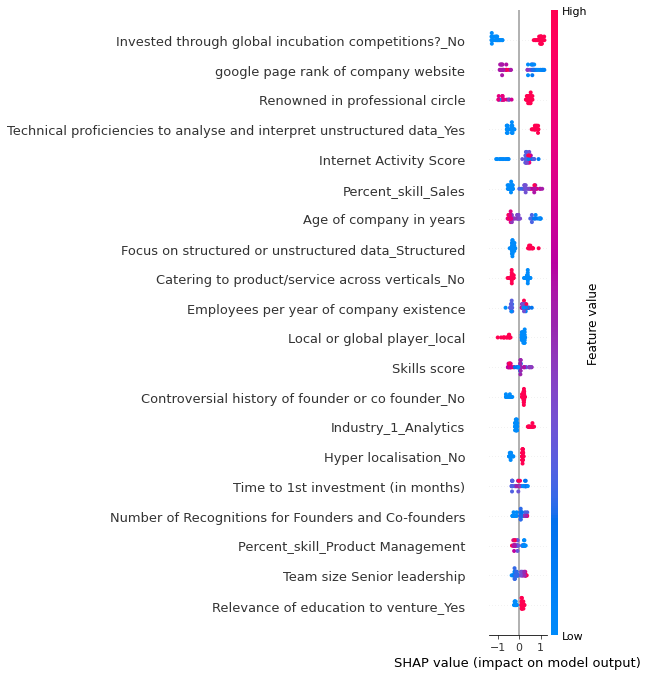

In [109]:
# Initializing KernelExplainer
mlp_explainer = shap.KernelExplainer(best_mlp_model.predict_proba, X_train_selected_1)

# Getting the SHAP values for all instances in your validation set (this might take a while)
mlp_shap_values = mlp_explainer.shap_values(X_test_selected_1)

# Plotting the SHAP values for all instances in your validation set (for class 0)
shap.summary_plot(xgb_shap_values, X_test_selected_1)

In [110]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score

# Parameter grid for Grid Search
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'saga']
}

# Logistic Regression Classifier
logreg = LogisticRegression(random_state=42)

grid_search = GridSearchCV(logreg, param_grid=param_grid, cv=10, n_jobs=-1)

# Fit model on training data
grid_search.fit(X_train_selected_1, Y_train)

# Print best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Predict on validation set
Y_pred = grid_search.predict(X_test_selected_1)

# Evaluate the Logistic Regression Classifier
print("Logistic Regression Classifier:")
print(classification_report(Y_test, Y_pred))
print("Accuracy:", accuracy_score(Y_test, Y_pred))
print("AUC-ROC:", roc_auc_score(Y_test, Y_pred))


Best hyperparameters: {'C': 0.1, 'penalty': 'l2', 'solver': 'saga'}
Logistic Regression Classifier:
              precision    recall  f1-score   support

           0       0.88      0.82      0.85        17
           1       0.91      0.94      0.92        31

    accuracy                           0.90        48
   macro avg       0.89      0.88      0.88        48
weighted avg       0.90      0.90      0.90        48

Accuracy: 0.8958333333333334
AUC-ROC: 0.8795066413662239


The max_iter was reached which means the coef_ did not converge


In [111]:
from joblib import dump

# Save lgr model after fitting and evaluation
dump(grid_search, 'lgr_models17.joblib')

['lgr_models17.joblib']

In [112]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Get the best RandomForest model from the grid search
best_lgr_model = grid_search.best_estimator_

# Instantiate a LIME explainer object
explainer = LimeTabularExplainer(X_train_selected_1.values, 
                                 feature_names=final_selected_features, 
                                 class_names=['Negative', 'Positive'], 
                                 mode='classification')

# Assuming that the first instance in the validation set is of interest
i = 1

# Get the explanation for the prediction on the ith instance in the validation set
exp = explainer.explain_instance(X_test_selected_1.values[i], best_lgr_model.predict_proba, num_features=5)

# Visualize the explanation
exp.show_in_notebook(show_all=False)


X does not have valid feature names, but LogisticRegression was fitted with feature names


In [113]:


dill.dump(explainer, open('lime_explainer_lgrs17.pkl', 'wb'))




# Save the LIME explainer
joblib.dump(explainer, 'lime_explainer_lgrs17.joblib')

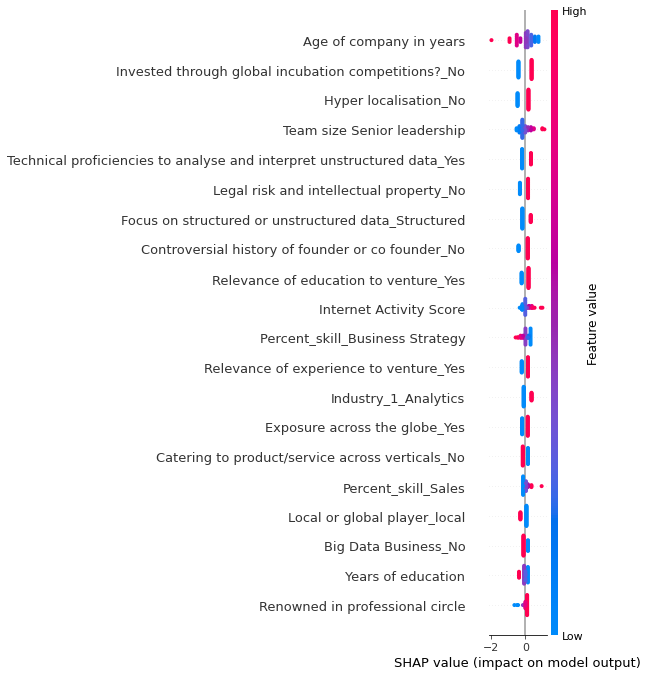

In [115]:
import shap

# Assuming `best_log_reg_model` is your best logistic regression model
# and it is well-fitted on your training data

# Initialize a Linear Explainer
log_reg_explainer = shap.LinearExplainer(best_lgr_model, X_train_selected_1)

# Get the SHAP values for all instances in your validation set
log_reg_shap_values = log_reg_explainer.shap_values(X_test_selected_1)

# Plot the SHAP values for the first instance in your validation set (for class 0)
shap.summary_plot(log_reg_shap_values, X_test_selected_1)
